# Self-Driving Car Nanodegree

## Project 4: Advanced Lane Finding

Miguel Morales | [@mimoralea](https://twitter.com/mimoralea) | [mimoralea@gmail.com](mailto:mimoralea@gmail.com)

In this project, we used advanced Computer Vision techniques to find road lane lines on images and video streams. First, we calibrated the camera obtaining the camera matrix and distortion coefficients. Then we created a pipeline of advanced methods to correctly identify lane line pixels, and finally applied these methods to video streams using confidence levels to detect and track the lines through the video.

### Camera Calibration

No sensor is perfect, and a camera is just one more sensor. To make sure the images and videos we get from cameras are the best possible representation of the world they are sensing, there are some calibration steps we can perform. Thankfully, OpenCV makes this process very straight-forward.

#### Obtaining matrix and coefficients

First, lets load some libraries and functions that we will be using throughout the project:

In [4]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from ipywidgets import (widgets, interactive, FloatSlider, IntSlider, \
                        IntRangeSlider, FloatRangeSlider, RadioButtons)
from scipy.misc import imread, imresize
from scipy.signal import find_peaks_cwt
from sklearn.preprocessing import normalize
from sklearn import datasets, linear_model
import numpy.polynomial.polynomial as poly

import numpy as np
import cv2
import pylab
import matplotlib.pyplot as plt
import glob

def get_calibration_coef(cal_imgs, nx=9, ny=6, plot=False):
    objpoints = []
    imgpoints = []
    drawnimgs = []

    objp = np.zeros((nx*ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

    fnames = glob.glob(cal_imgs)

    for fname in fnames:
        img = imread(fname)

        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        # if chessboard corners were not found, continue to next image
        if not ret:
            continue

        # save the points to calibrate later
        imgpoints.append(corners)
        objpoints.append(objp)

        # no need to waste cycles if do not want plotting
        if not plot:
            continue

        # draw points in the img and save a copy
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        drawnimgs.append(img)
    return objpoints, imgpoints, drawnimgs

def calibrate(img_shape, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
        objpoints, imgpoints, img_shape, None, None)
    return mtx, dist

def undistort(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

def cal_undistort(img, objpoints, imgpoints, mtx=None, dist=None):

    if mtx==None or dist==None:
        mtx, dist = calibrate(img.shape[0:2], objpoints, imgpoints)

    undist = undistort(img, mtx, dist)
    return undist, mtx, dist

def plot_imgs(imgs, titles=None):
    fig = plt.figure(figsize=(20,50))
    for i in range(len(imgs)):
        img = imgs[i]

        ax = fig.add_subplot(9, 3, i + 1)
        ax.grid(False)
        ax.get_xaxis().set_ticks([])
        ax.get_yaxis().set_ticks([])
        ax.imshow(img, cmap='gray')
        if titles != None:
            ax.set_title(titles[i], fontsize=50)
    plt.show()

def plot_side_by_side(img1, title1, img2, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img1, cmap='gray')
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(img2, cmap='gray')
    ax2.set_title(title2, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

def get_perspective(img_size, src=None, dst=None, inv=False):
    x, y = img_size

    if src == None or dst == None:
        src = np.float32([
                (180, 680), (595, 440), (685, 440), (1280, 680),
            ])    
        dst = np.float32([
                (530, 720), (530, 0), (760, 0), (760, 720)
            ])

    return cv2.getPerspectiveTransform(src, dst) if not inv else cv2.getPerspectiveTransform(dst, src)


def unwarp(img, mtx, dist):
    img_size = (img.shape[1], img.shape[0])    
    x, y = img_size

    src = np.float32([
            (180, 680), (595, 440), (685, 440), (1280, 680),
        ])    
    dst = np.float32([
            (530, 720), (530, 0), (760, 0), (760, 720)
        ])

    unwarpped, M = corners_unwarp(img, mtx, dist, src, dst)
    return unwarpped, M

def corners_unwarp(img, mtx, dist, src=None, dst=None):
    img_size = (img.shape[1], img.shape[0])
    M = get_perspective(img_size, src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags = cv2.INTER_LINEAR)
    return warped, M

Next, we can obtain the calibration matrix and coefficients from the provided images:

In [5]:
udobjpoints, udimgpoints, udimgs = get_calibration_coef('ud_cal/calibration*.jpg', plot=True)

Also, Let's take a look at the images that we used to obtain the calibration parameters:

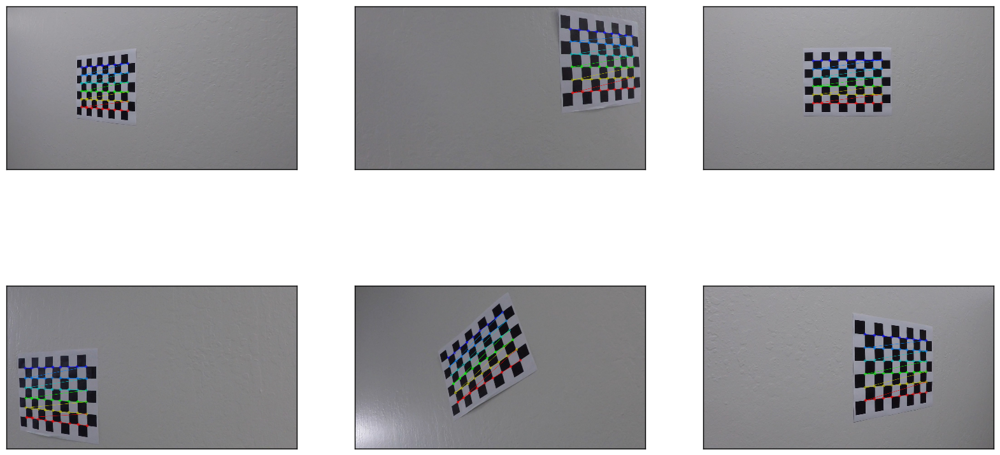

In [6]:
plot_imgs(udimgs[0:6])

We will also be using some images and videos taken with another camera, so let's obtain the matrix and coefficients for this camera as well. Additionally, let's also plot some of the images we used to do this new calibration.

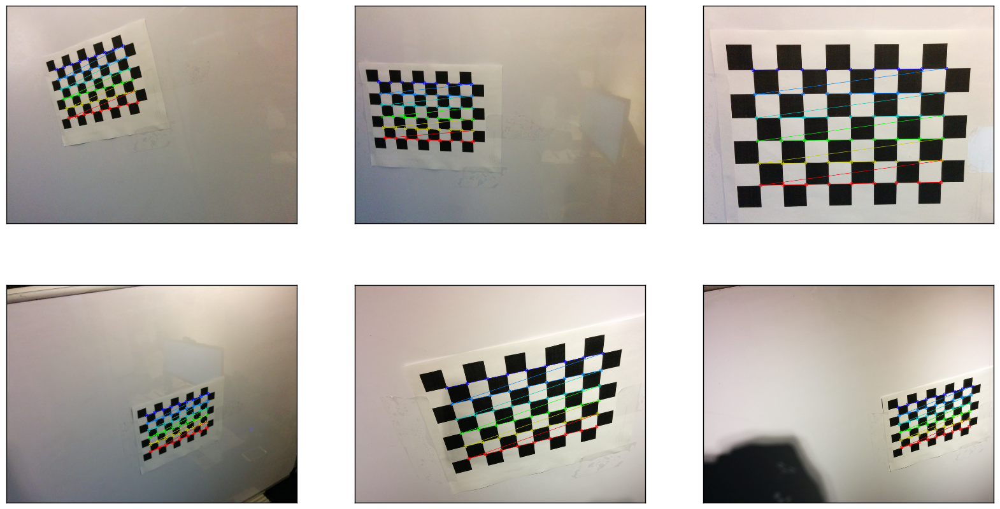

In [7]:
myobjpoints, myimgpoints, myimgs = get_calibration_coef('my_cal/calibration*.jpg', plot=True)
plot_imgs(myimgs[0:6])

#### Undistorting test images

We obtained the matrices and coefficients from the previous step. These values can be used to distort new images we pass into. But also, from this step, we get a matrix and a distortion values that we can reuse later on.

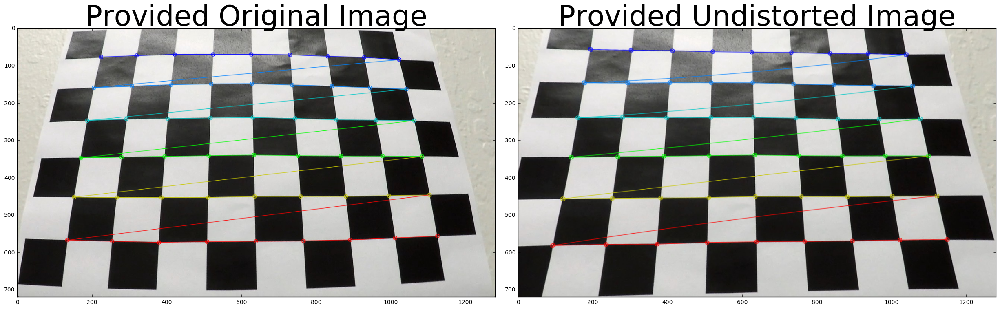

AttributeError: module 'matplotlib.pyplot' has no attribute 'save'

In [133]:
udimg = udimgs[10]
udundistorted, udmtx, uddist = cal_undistort(udimg, udobjpoints, udimgpoints)
plot_side_by_side(udimg, 'Provided Original Image', udundistorted, 'Provided Undistorted Image')
plt.save('output_images/checkboard_distorted.png')

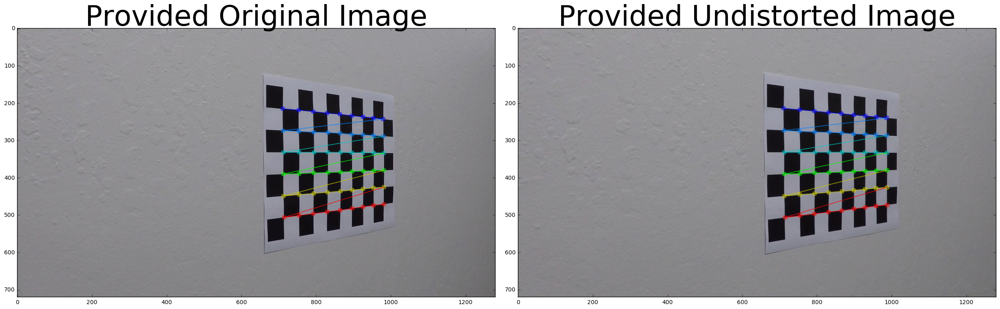

In [9]:
udimg = udimgs[5]
udundistorted, udmtx, uddist = cal_undistort(udimg, udobjpoints, udimgpoints, udmtx, uddist)
plot_side_by_side(udimg, 'Provided Original Image', udundistorted, 'Provided Undistorted Image')

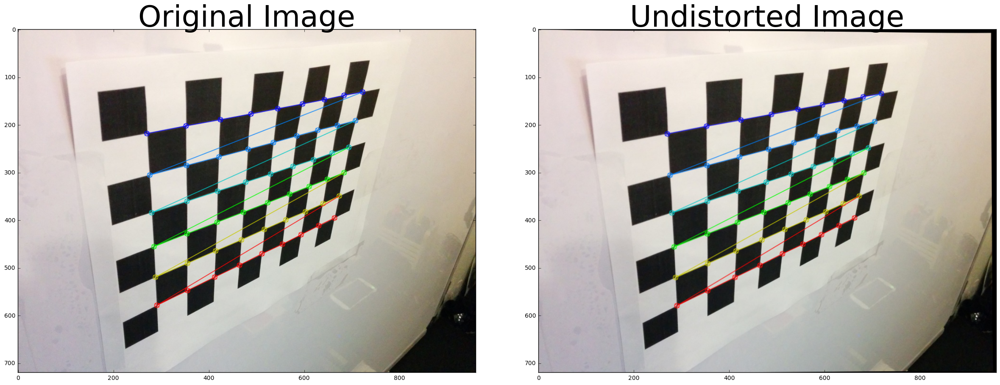

In [10]:
myimg = myimgs[-3]
myundistorted, mymtx, mydist = cal_undistort(myimg, myobjpoints, myimgpoints)
plot_side_by_side(myimg, 'Original Image', myundistorted, 'Undistorted Image')

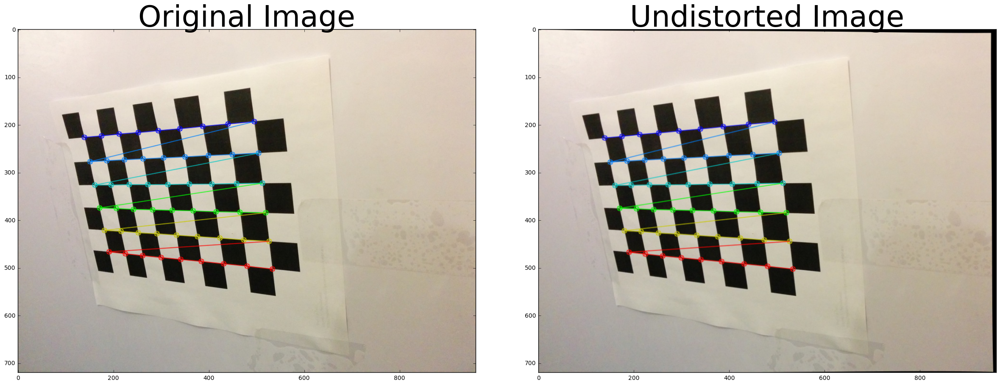

In [11]:
myimg = myimgs[10]
myundistorted, mymtx, mydist = cal_undistort(myimg, myobjpoints, myimgpoints, mymtx, mydist)
plot_side_by_side(myimg, 'Original Image', myundistorted, 'Undistorted Image')

Excellent. In steps above, we were able to calibrate a camera and use it to undistort images. Let's now work into building an advanced Computer Vision pipeline to effectively detect and track lane lines on roads.

### Pipeline

In this section, we will dive deep into the Computer Vision techniques used to detect lane lines in roads of diverse conditions. First, we will look at each processing step of the pipeline in detail, and then we will create a function to process images with a single call. Additionally, we will be looking at two sample images side by side. The first image shows two dashed white lines with only a shade interrupting the flow of the lane, the second image however, shows multiple potential issues for the lane detection. The left line is continuous and yellow, while the right is white. Also, there is a big change in the roads from asphalt to concrete. Let's take a look.

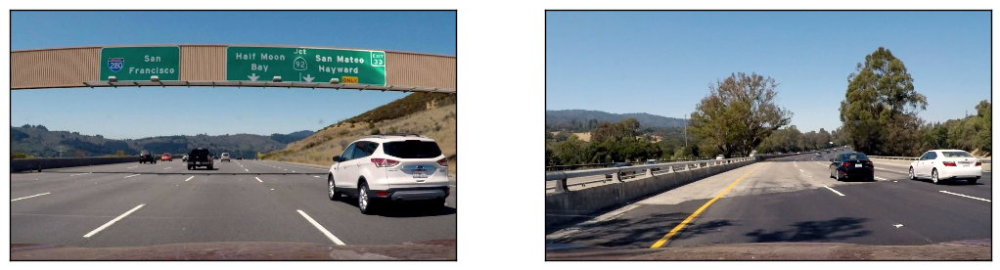

In [12]:
udimg1 = imread('ud_images/signs_vehicles_xygrad.jpg')
udimg2 = imread('ud_images/test4.jpg')

plot_imgs([udimg1, udimg2])

#### Distortion Correction

The first step of the pipeline is to correct the distortion of the image above. As we can see, this camera clearly shows radial distortion as we can see how some lines that appear to be curved intuitively shouldn't. Good news is, we already have the camera matrix and distortion coefficients, so we can simply use these values to undistort any new image.

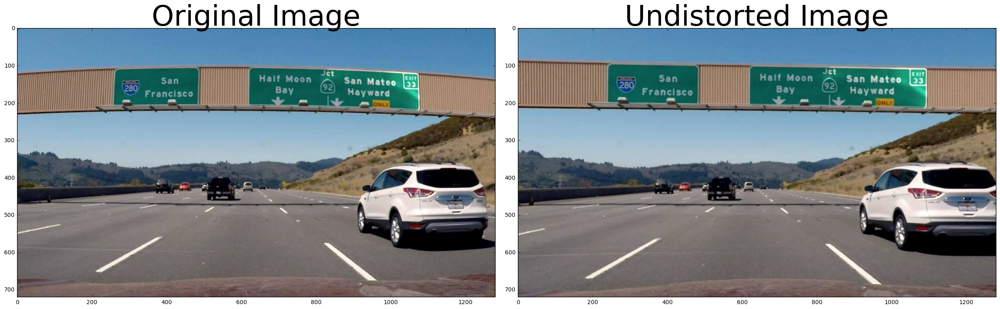

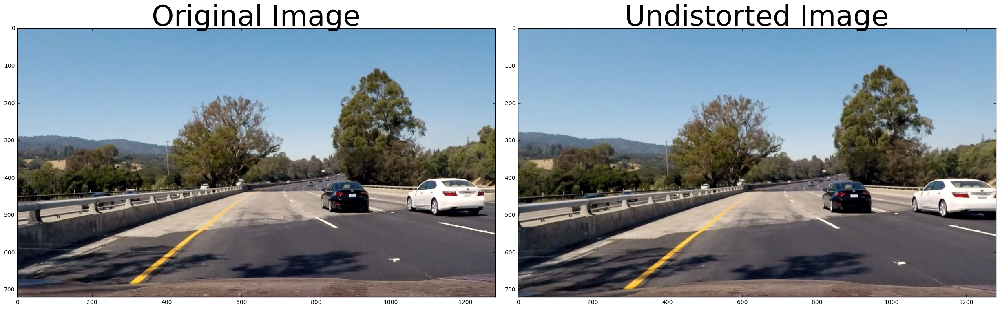

In [13]:
und1 = undistort(udimg1, udmtx, uddist)
und2 = undistort(udimg2, udmtx, uddist)
plot_side_by_side(udimg1, 'Original Image', und1, 'Undistorted Image')
plot_side_by_side(udimg2, 'Original Image', und2, 'Undistorted Image')

We can do the same for our camera:

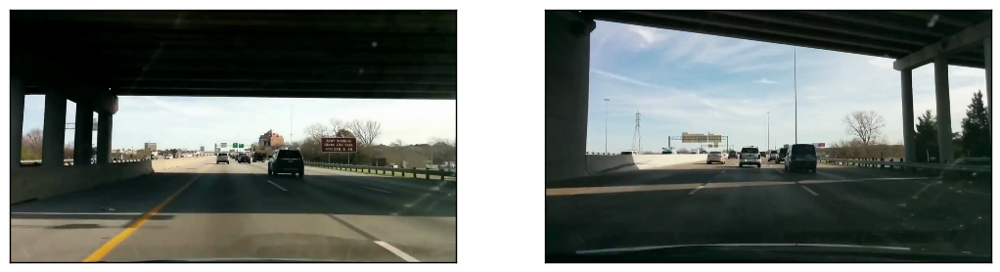

In [11]:
myimg1 = imread('my_images/vlcsnap-00001.png')
myimg2 = imread('my_images/vlcsnap-00006.png')

plot_imgs([myimg1, myimg2])

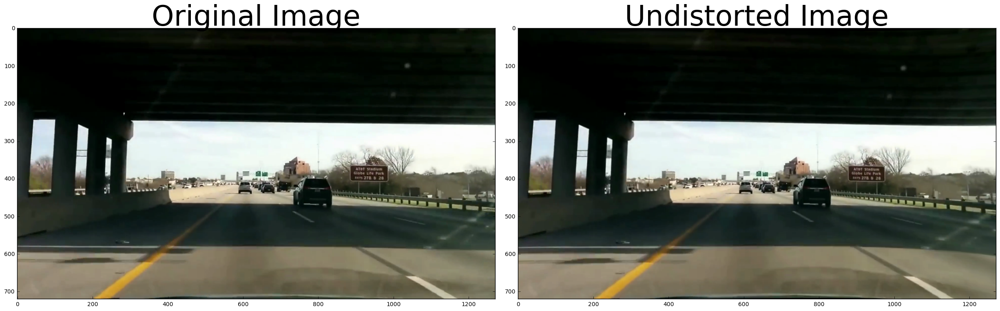

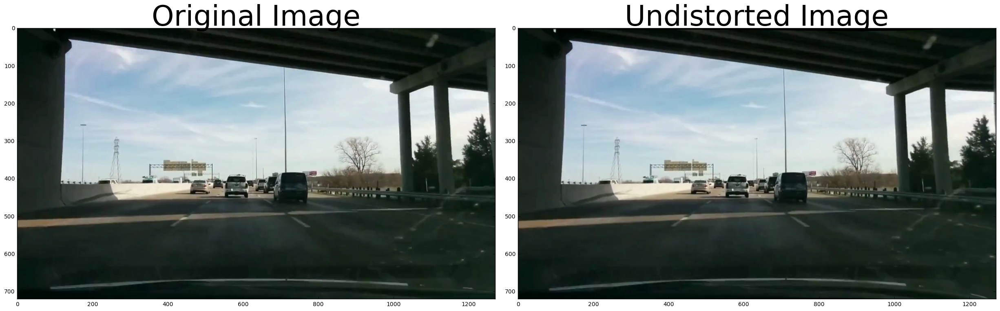

In [12]:
mnd1 = undistort(myimg1, mymtx, mydist)
mnd2 = undistort(myimg2, mymtx, mydist)
plot_side_by_side(myimg1, 'Original Image', mnd1, 'Undistorted Image')
plot_side_by_side(myimg2, 'Original Image', mnd2, 'Undistorted Image')

#### Perspective Transform

The following function will serve to change the perspective of the images:

In [13]:
def unwarp(img, mtx, dist):
    img_size = (img.shape[1], img.shape[0])    
    x, y = img_size

    src = np.float32([
            (180, 680), (595, 440), (685, 440), (1280, 680),
        ])    
    dst = np.float32([
            (530, 720), (530, 0), (760, 0), (760, 720)
        ])

    unwarpped, M = corners_unwarp(img, mtx, dist, src, dst)
    return unwarpped, M

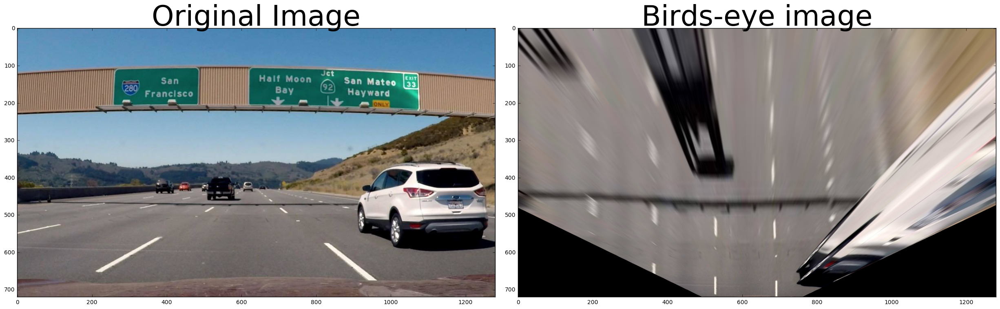

In [14]:
org = udimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
plot_side_by_side(org, 'Original Image', warp, 'Birds-eye image')

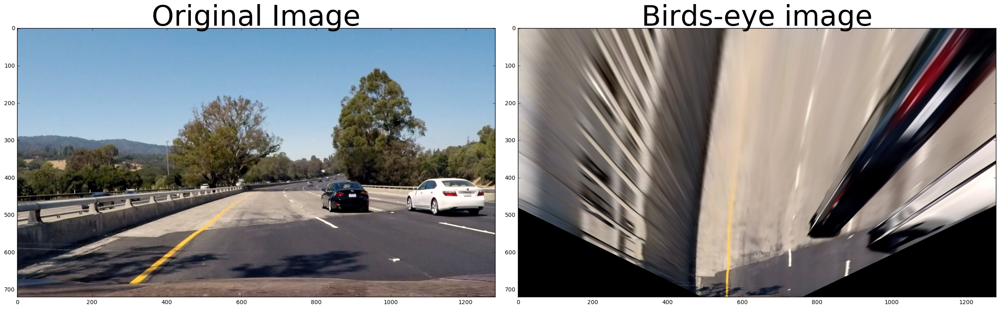

In [15]:
org = udimg2
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
plot_side_by_side(org, 'Original Image', warp, 'Birds-eye image')

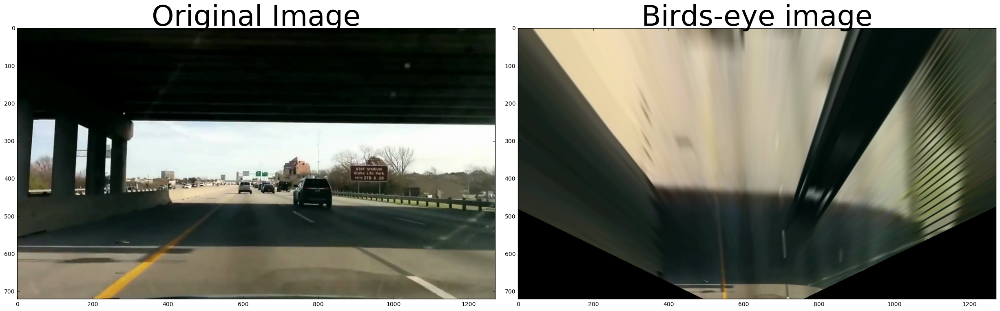

In [16]:
org = myimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
plot_side_by_side(org, 'Original Image', warp, 'Birds-eye image')

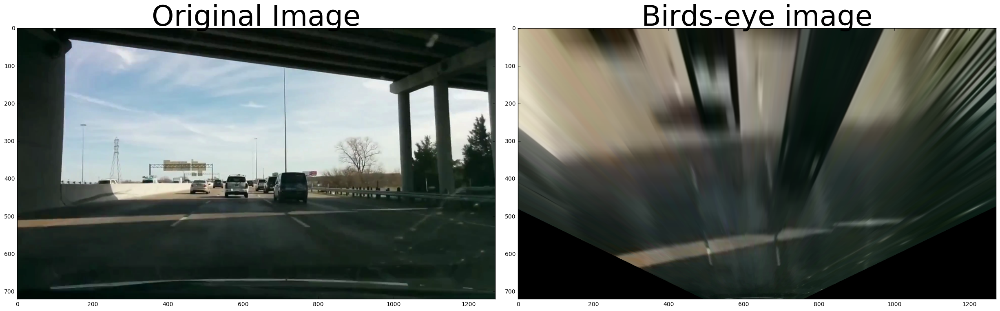

In [17]:
org = myimg2
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
plot_side_by_side(org, 'Original Image', warp, 'Birds-eye image')

#### Binary Image Creation

First, let's add some functions to use for the binary images exploration.

In [18]:
def grayscale(img):
    """
    Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    you should call plt.imshow(gray, cmap='gray')
    """
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
def canny(img, low_threshold, high_threshold):
    """
    Applies the Canny transform
    """
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """
    Applies a Gaussian Noise kernel
    """
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def hough_lines(img, rho = 2, theta = np.pi/180, threshold = 10, 
                min_line_len = 50, max_line_gap = 50):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), 
                            minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((*img.shape, 3), dtype=np.uint8)
    return line_img, lines

def draw_lines(img, lines, color=[255, 0, 0], thickness=10):
    """
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    for line in lines:
        line[np.isnan(line)] = 0
        x1, y1, x2, y2 = line.astype(int)
        cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    gray = img
    
    # 1) Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    sobel = sobelx if orient == 'x' else sobely
    
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scale_factor = np.max(abs_sobel)/255 
    scaled_sobel = (abs_sobel/scale_factor).astype(np.uint8) 
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary = np.zeros_like(scaled_sobel)
    binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    gray = img
    
    # 1) Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    # 3) Take the absolute value of the derivative or gradient
    sobel_mag = np.sqrt(np.square(sobelx) + np.square(sobely))    
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scale_factor = np.max(sobel_mag)/255 
    scaled_sobel = (sobel_mag/scale_factor).astype(np.uint8) 
    
    # 5) Create a mask of 1's where the scaled gradient magnitude
    binary = np.zeros_like(scaled_sobel)
    binary[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = img
    
    # 1) Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    dirgrad = np.arctan2(abs_sobely, abs_sobelx)
    
    # 5) Create a binary mask where direction thresholds are met
    binary = np.zeros_like(dirgrad, dtype=int)
    binary[(dirgrad > thresh[0]) & (dirgrad < thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def hls_select(img, selection='l', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    # 2) Apply a threshold to the S channel
    q = H if selection=='h' else L if selection=='l' else S
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
    
    return binary

def hsv_select(img, selection='s', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    H = hsv[:,:,0]
    S = hsv[:,:,1]
    V = hsv[:,:,2]

    q = H if selection=='h' else S if selection=='s' else V
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
    
    return binary

def rgb_select(img, selection='r', thresh=(0, 255)):
    # 1) Convert to HLS color space
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]
    
    q = R if selection=='r' else G if selection=='g' else B
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
        
    return binary

def filter_yellow(img):
    img = cv2.GaussianBlur(img, (1, 1), 0)
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    mask = cv2.inRange(hsv, 
                       (10, 80, 170), 
                       (40, 225, 225))
    return mask
    
def filter_white(img):
    mask = cv2.inRange(img, 
                       (165, 165, 175), 
                       (255, 255, 255))
    return mask

def get_peaks(img, middle):
    histogram = np.sum(img[500:,:], axis=0)
    histogram[histogram < 15] = 0
    peaks = np.array(find_peaks_cwt(histogram, np.arange(15, 30)))

    print(peaks)
    lefts = np.sort(peaks[peaks < middle])[::-1]
    rights = np.sort(peaks[peaks > middle])

    possible_pairs = []
    dist = (155, 185)
    for left in lefts:
        lowest = left + dist[0]
        highest = left + dist[1]
        print('lowest', lowest)
        print('highest', highest)
        subset_possible = peaks[peaks > lowest]
        print('remove lows', subset_possible)
        subset_possible = subset_possible[subset_possible < highest]
        print('remove highs', subset_possible)
        if len(subset_possible) > 0:
            # get first possible
            possible_pairs.append((left, subset_possible[0]))
            
    print(possible_pairs)
    for pair in possible_pairs:
        cv2.line(img, (pair[0], 0), (pair[0], y), 1, 1)
        cv2.line(img, (pair[1], 0), (pair[1], y), 1, 1)

    cv2.line(sx, (middle, 0), (middle, y), 1, 1)
    f, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 15))
    f.tight_layout()
    ax1.imshow(img, cmap='gray')
    plt.setp(ax1.get_xticklabels(), visible=False)
    ax2 = plt.subplot(212, sharex=ax1)
    plt.plot(histogram)
    plt.show()
    
    return possible_pairs

First, we will explore the different color models. RGB, HLS and HSV, to be more exact. Then, we will look at different kinds of thresholds. Finally, we will look at a couple of good combinations and the combination that we selected as our binary pipeline.

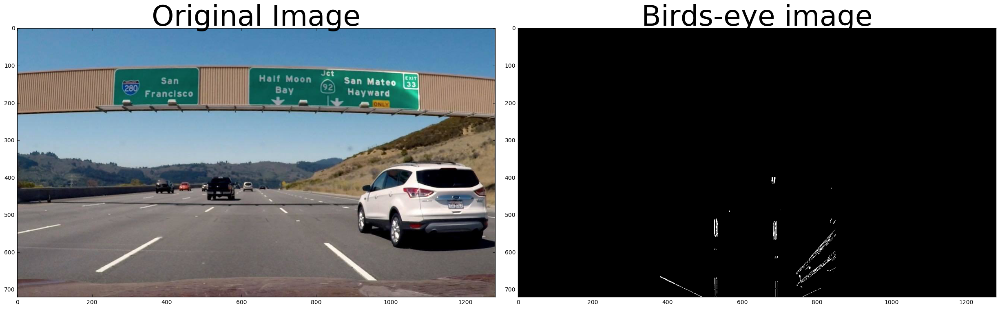

[529 689 832]
lowest 684
highest 714
remove lows [689 832]
remove highs [689]
[(529, 689)]


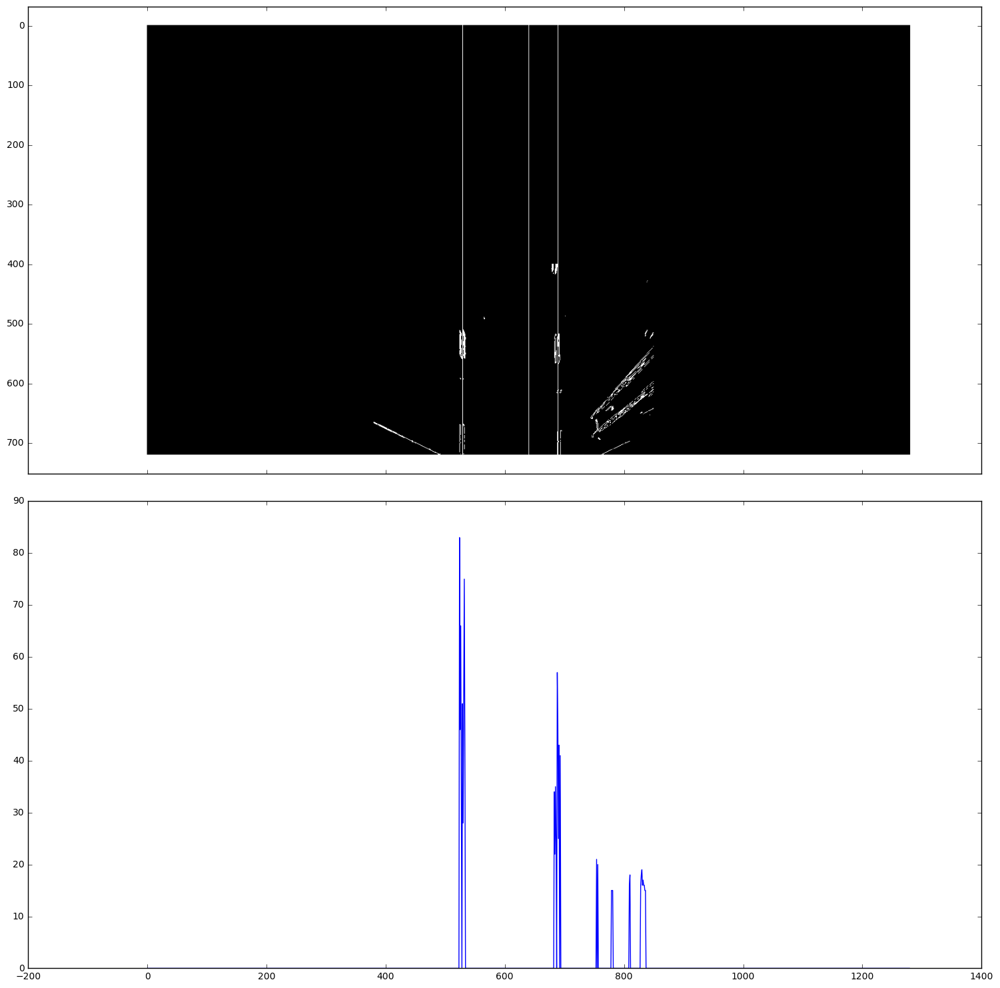

[(529, 689)]


In [19]:
org = udimg1
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

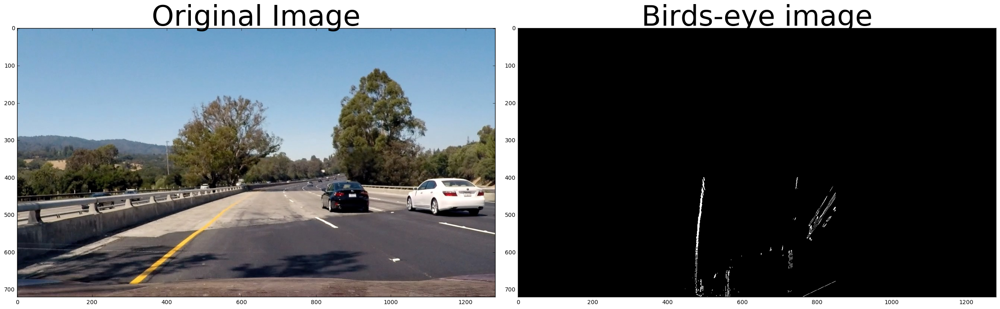

[481 561 783]
lowest 716
highest 746
remove lows [783]
remove highs []
lowest 636
highest 666
remove lows [783]
remove highs []
[]


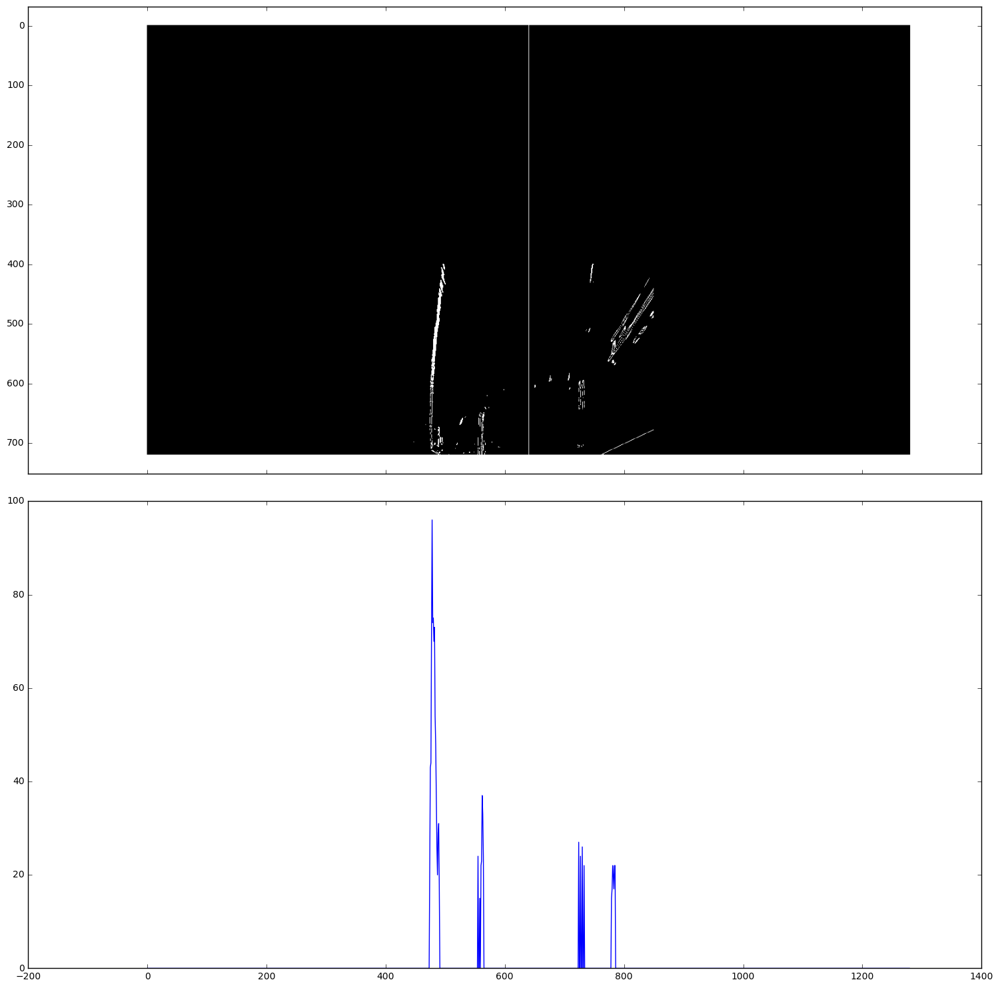

[]


In [20]:
org = udimg2
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

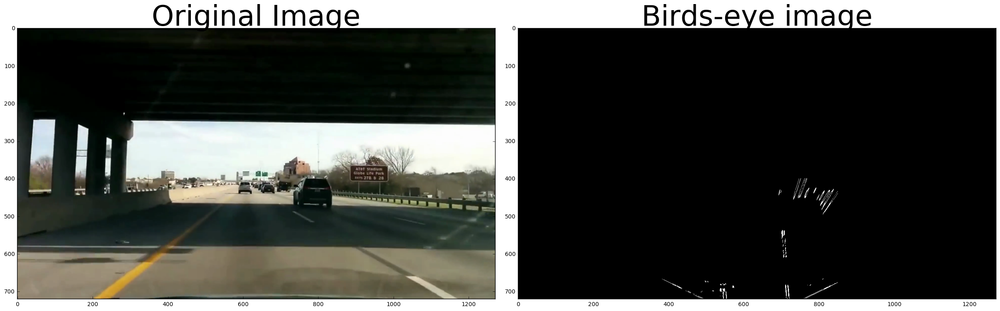

[547 710]
lowest 702
highest 732
remove lows [710]
remove highs [710]
[(547, 710)]


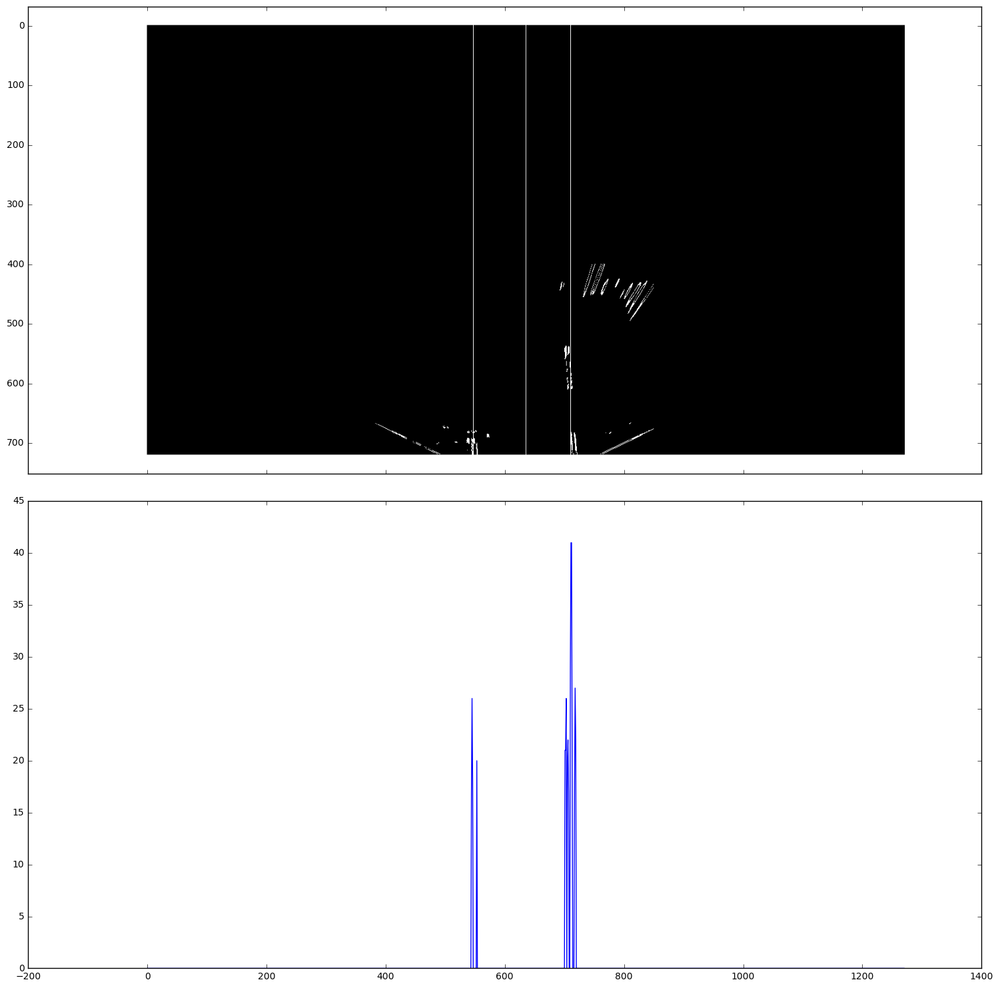

[(547, 710)]


In [21]:
org = myimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

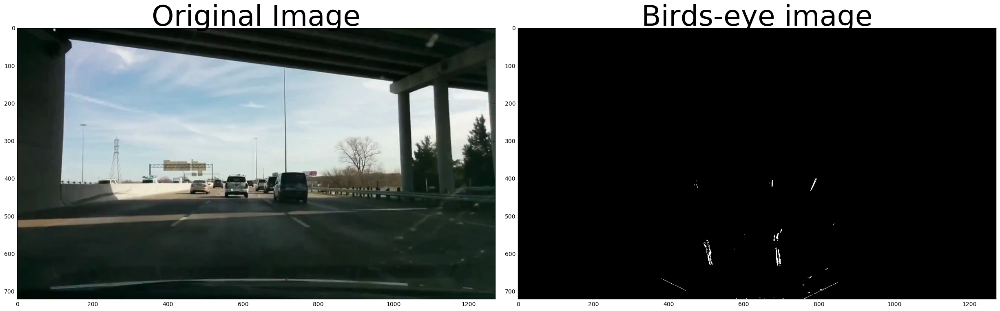

[509 691]
lowest 664
highest 694
remove lows [691]
remove highs [691]
[(509, 691)]


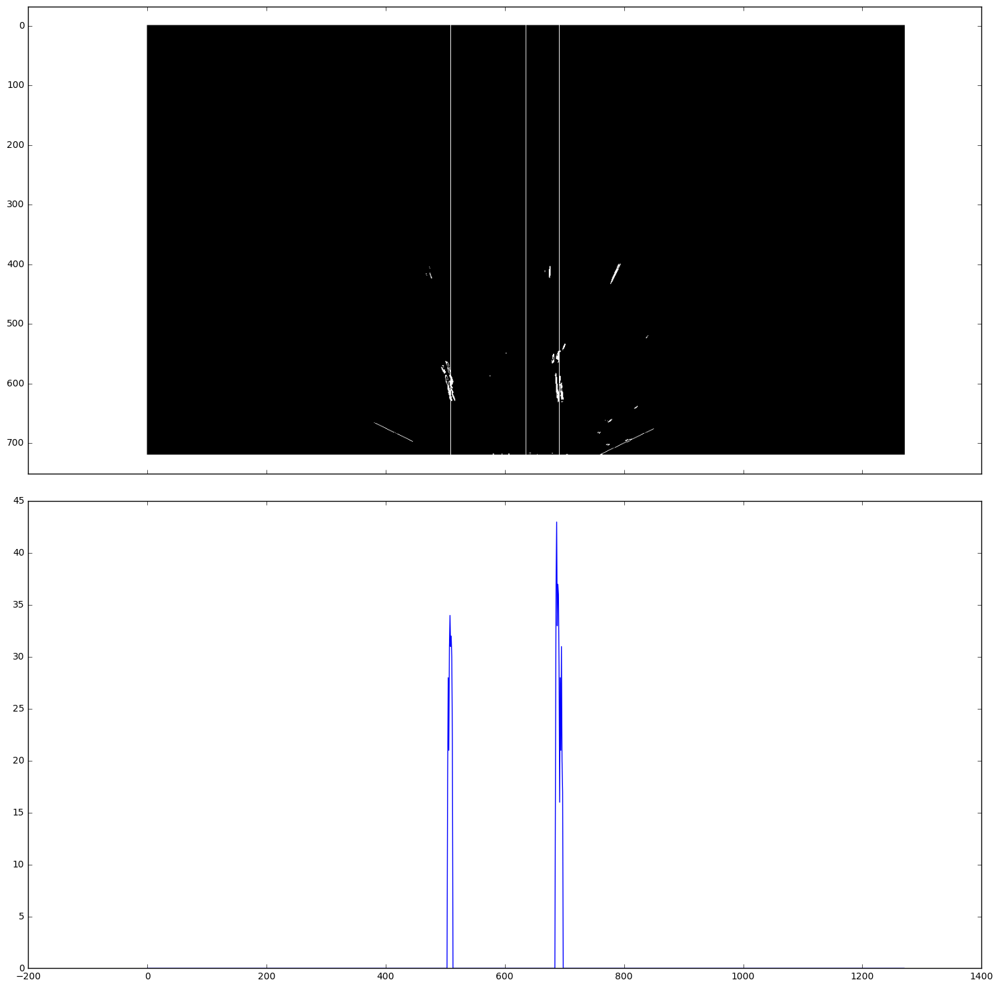

[(509, 691)]


In [22]:
org = myimg2
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

Once we detect the initials segments of the lane line, we want to use a window method to search for the continuations.

In [67]:
def get_peaks(img, middle):
    histogram = np.sum(img[600:,:], axis=0)
    histogram[histogram < 15] = 0
    peaks = np.array(find_peaks_cwt(histogram, np.arange(15, 30)))

    # print(peaks)
    lefts = np.sort(peaks[peaks < middle])[::-1]
    rights = np.sort(peaks[peaks > middle])

    possible_pairs = []
    dist = (155, 185)
    for left in lefts:
        lowest = left + dist[0]
        highest = left + dist[1]
        #print('lowest', lowest)
        #print('highest', highest)
        subset_possible = peaks[peaks > lowest]
        #print('remove lows', subset_possible)
        subset_possible = subset_possible[subset_possible < highest]
        #print('remove highs', subset_possible)
        if len(subset_possible) > 0:
            # get first possible
            possible_pairs.append((left, subset_possible[0]))
  
    # print(possible_pairs)
    for pair in possible_pairs:
        #cv2.line(img, (pair[0], 0), (pair[0], y), 1, 1)
        #cv2.line(img, (pair[1], 0), (pair[1], y), 1, 1)
        break
    #cv2.line(sx, (middle, 0), (middle, y), 1, 1)
    """
    f, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 15))
    f.tight_layout()
    ax1.imshow(img, cmap='gray')
    plt.setp(ax1.get_xticklabels(), visible=False)
    ax2 = plt.subplot(212, sharex=ax1)
    plt.plot(histogram)
    plt.show()
    """
    return possible_pairs


def get_window_values(img, starty, endy, startx, endx, 
                      thresh=(0.2, 5, 10)):
    
    window_img = img[starty:endy,startx:endx]
    hist = np.sum(window_img, axis=0)
    hist = hist / np.linalg.norm(hist)
    hist[hist < thresh[0]] = 0
    peaks = np.array(find_peaks_cwt(hist, np.arange(
                thresh[1], thresh[2])))
    return window_img, hist, peaks

def get_peak_displacement(x, my_peaks, other_peaks):
    
    if len(my_peaks) == 0 and len(other_peaks) == 1:
        return other_peaks[0]
    if len(my_peaks) > 0:
        idx = (np.abs(my_peaks-x)).argmin()
        return my_peaks[idx]
    return x

def draw_window_outline(img, window_left_x, window_right_x, 
                        bottom_y, upper_y, col=((255,)*3), 
                        thickness=2):
    cv2.line(img, (window_left_x, bottom_y), 
             (window_left_x, upper_y), col, thickness)
    cv2.line(img, (window_right_x, bottom_y), 
             (window_right_x, upper_y), col, thickness)
    cv2.line(img, (window_left_x, upper_y), 
             (window_right_x, upper_y), col, thickness)
    cv2.line(img, (window_left_x, bottom_y), 
             (window_right_x, bottom_y), col, thickness)
    return img


def clamp_values_to_lane_width(left_window_values, 
                               right_window_values, 
                               initial_lane_width):

    left_window_x, xl, wxl = left_window_values
    right_window_x, xr, wxr = right_window_values
    
    # calculate a default value
    new_wxl = left_window_x + xl
    new_wxr = right_window_x + xr

    new_lane_width = abs(new_wxr - new_wxl)
    lane_width_diff = abs(initial_lane_width - new_lane_width)
    if lane_width_diff >= 20:
        if abs(new_wxr - wxr) < abs(new_wxl - wxl):
            # inverse the values
            new_wxl = left_window_x + xr
        else:
            
            new_wxr = right_window_x + xl
    return new_wxl, new_wxr

def draw_middle_lines(img, left, right, bottom, top, 
                      color_left, color_right, thickness):

    cv2.line(img, (left, bottom), 
             (left, top), color_left, thickness)
    cv2.line(img, (right, bottom), 
             (right, top), color_right, thickness)
    return img


def draw_lane_lines(img, wxl, wxr, col, debug=False):
    dark = np.zeros_like(img).astype(np.uint8)
    color_dark = np.dstack((dark, dark, dark))

    bina = detect_binary_lines(col)
    bina[bina != 255] = 0
    bina[bina == 255] = 1

    y, x = img.shape
    wys, wxs = (100,100)
    lane_width = wxr - wxl
    
    centroids = []
    for wy in np.arange(y, 20, -100):
        # print(wy, wxl, ' -- ', wy, wxr)
        left_window_left_x, left_window_right_x = wxl-wxs//2, wxl+wxs//2
        right_window_left_x, right_window_right_x = wxr-wxs//2, wxr+wxs//2
        upper_y, bottom_y = (0 if wy == 120 else wy-wys), wy
        
        left_window_img, left_hist, left_peaks = get_window_values(
            img, upper_y, bottom_y, left_window_left_x, left_window_right_x)
        
        right_window_img, right_hist, right_peaks = get_window_values(
            img, upper_y, bottom_y, right_window_left_x, right_window_right_x)

        if len(left_peaks) == 0:
            left_window_img, left_hist, left_peaks = get_window_values(
                bina, upper_y, bottom_y, left_window_left_x, left_window_right_x)

        if len(right_peaks) == 0:
            right_window_img, right_hist, right_peaks = get_window_values(
                bina, upper_y, bottom_y, right_window_left_x, right_window_right_x)

        xl = get_peak_displacement(wxs//2, left_peaks, right_peaks)
        xr = get_peak_displacement(wxs//2, right_peaks, left_peaks)
        
        # drawing selected window images and histograms
        if debug:
            f, ((ax1, ax2),(ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 15))
            f.tight_layout()
            ax1.imshow(left_window_img, cmap='gray')
            plt.setp(ax1.get_xticklabels(), visible=False)
            ax2.imshow(right_window_img, cmap='gray')
            plt.setp(ax2.get_xticklabels(), visible=False)
            ax3.plot(left_hist)
            ax4.plot(right_hist)
            plt.show()

        # draw left window
        draw_window_outline(color_dark, left_window_left_x, 
                            left_window_right_x, 
                            bottom_y, upper_y)

        draw_window_outline(col, left_window_left_x, 
                            left_window_right_x, 
                            bottom_y, upper_y)

        # draw right windows
        draw_window_outline(color_dark, right_window_left_x, 
                            right_window_right_x, 
                            bottom_y, upper_y)

        draw_window_outline(col, right_window_left_x, 
                            right_window_right_x, 
                            bottom_y, upper_y)

        new_wxl, new_wxr = clamp_values_to_lane_width(
            (left_window_left_x, xl, wxl), 
            (right_window_left_x, xr, wxr), 
            lane_width)

        color_left = (255,0,0) if len(left_peaks) == 0 else (0,255,0)
        color_right = (255,0,0) if len(right_peaks) == 0 else (0,255,0)
        draw_middle_lines(col, new_wxl, new_wxr, 
                          bottom_y, upper_y, color_left, color_right, 3)

        draw_middle_lines(color_dark, new_wxl, new_wxr, 
                          bottom_y, upper_y, color_left, color_right, 10)

        centroids.append((new_wxl, new_wxr, bottom_y))

        if len(centroids) < 5:
            # move windows over x axis
            wxl, wxr = new_wxl, new_wxr
        else:
            data = np.array(centroids)
            l = data[:,0]
            r = data[:,1]
            y = data[:,2]
            nwind = bottom_y - 100

            coefsl = poly.polyfit(y, l, 2)
            coefsr = poly.polyfit(y, r, 2)
            
            wxl = int(poly.polyval(nwind, coefsl))
            wxr = int(poly.polyval(nwind, coefsr))

        """
        # if found exactly 1 for both reduce window size
        if len(left_peaks) == 1 or len(right_peaks) == 1:
            wys, wxs = (100, np.max([70, int(wxs*.9)]))
            print('confident')
        else:
            wys, wxs = (np.min([150, int(wxs*1.2)]), 100)
            print('unsure')
        print('window size for next iteration, (y, x)')
        """
    if debug:
        plot_imgs([img, bina, col, color_dark])
    return [img, bina, col, color_dark], centroids

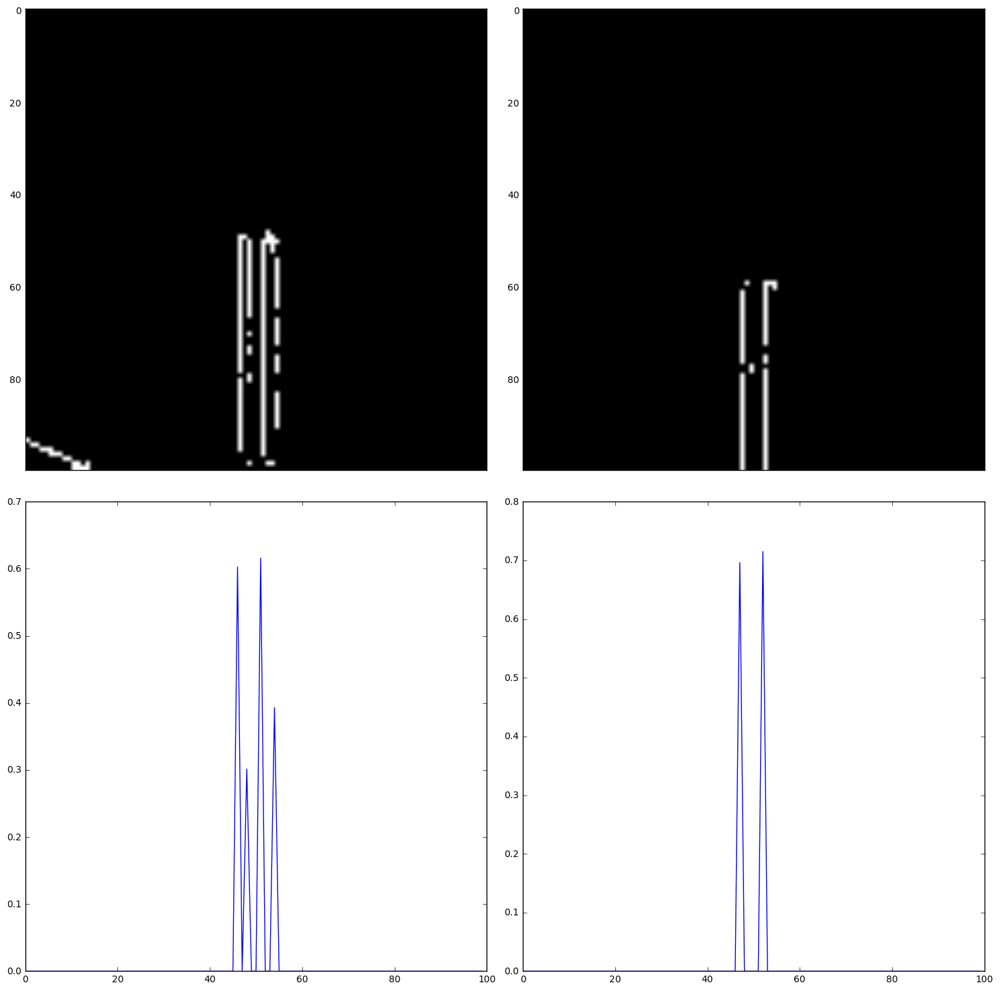

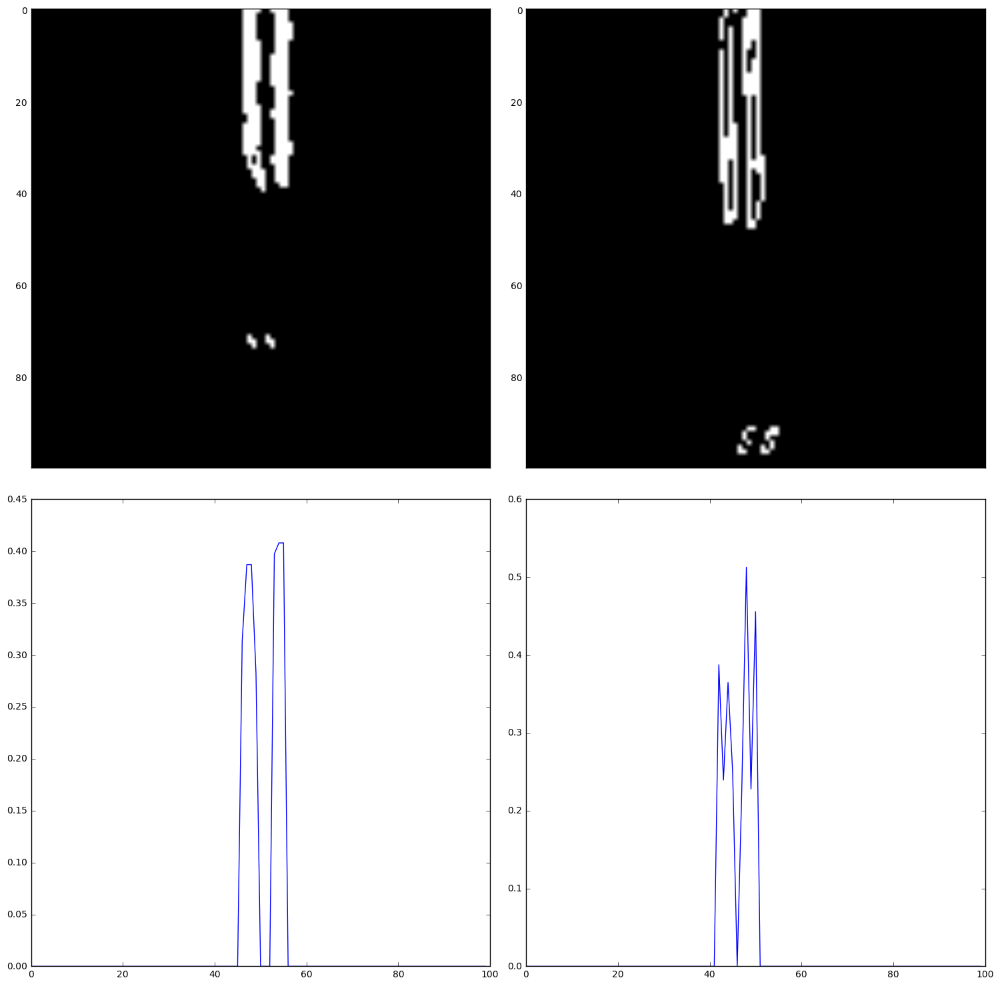

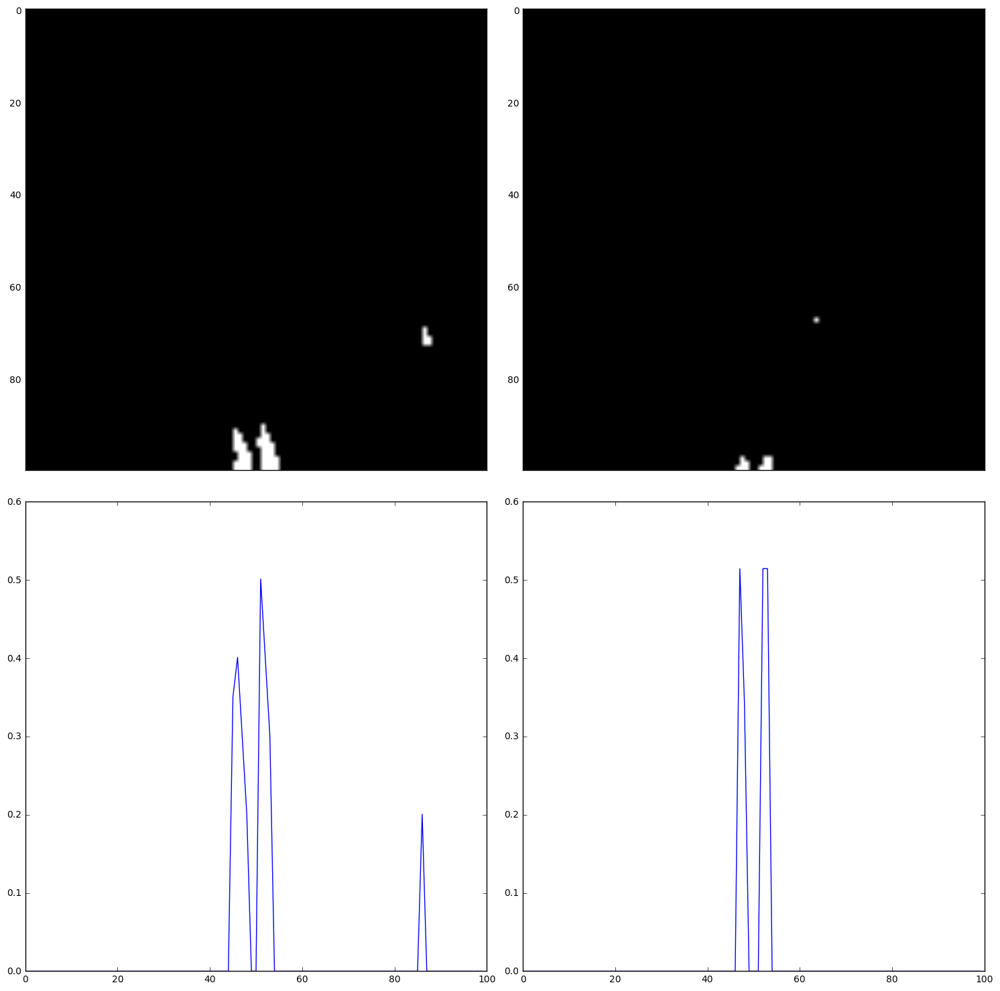

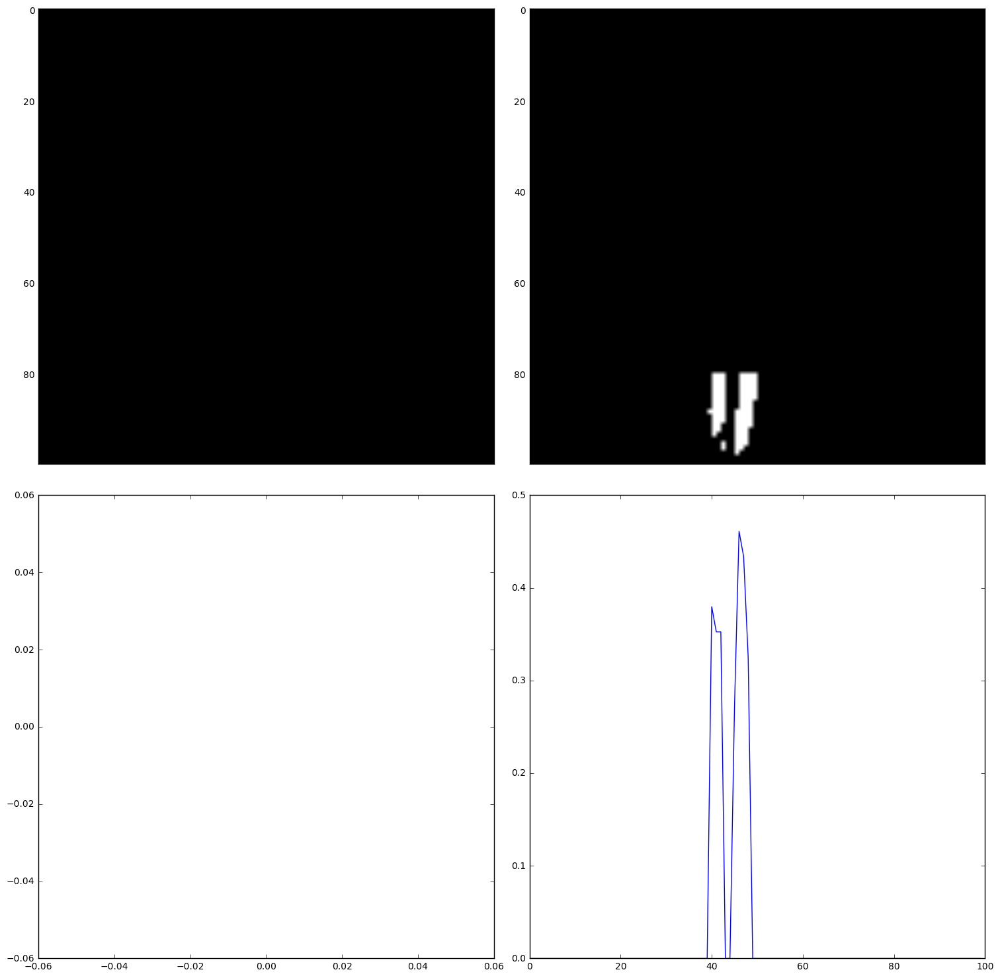

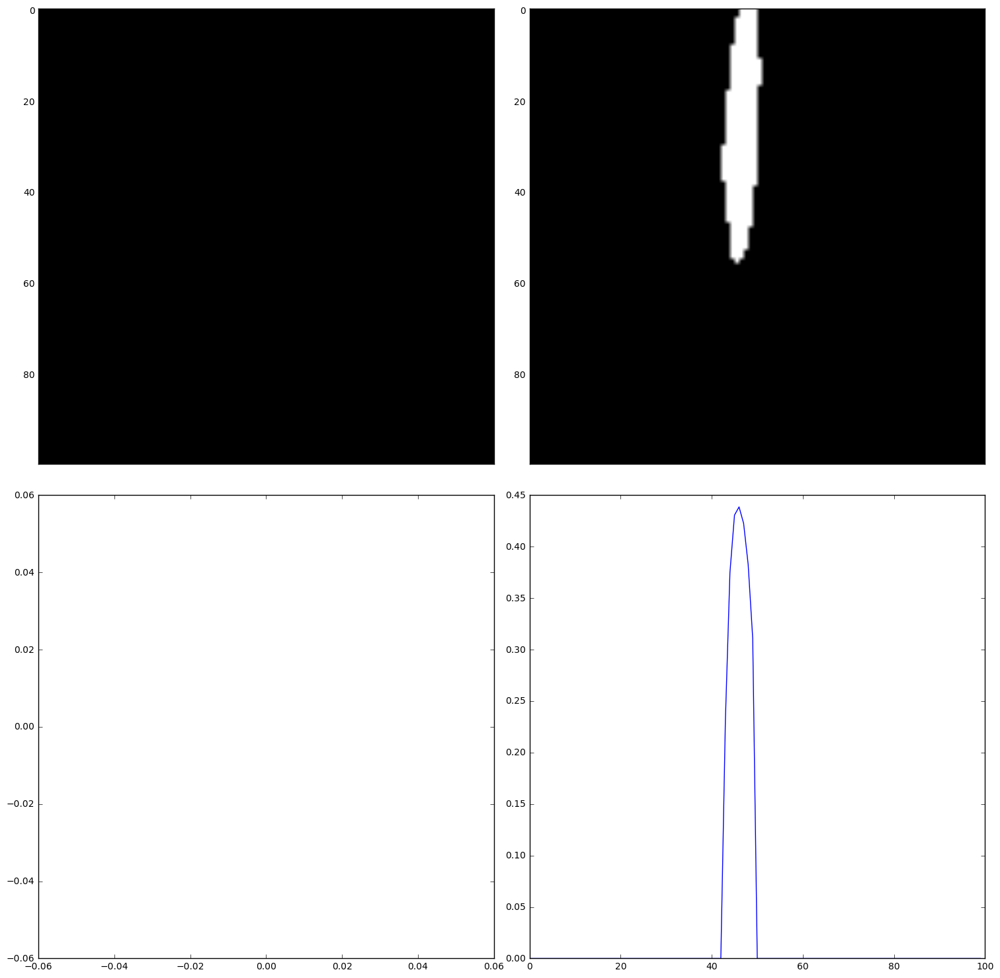

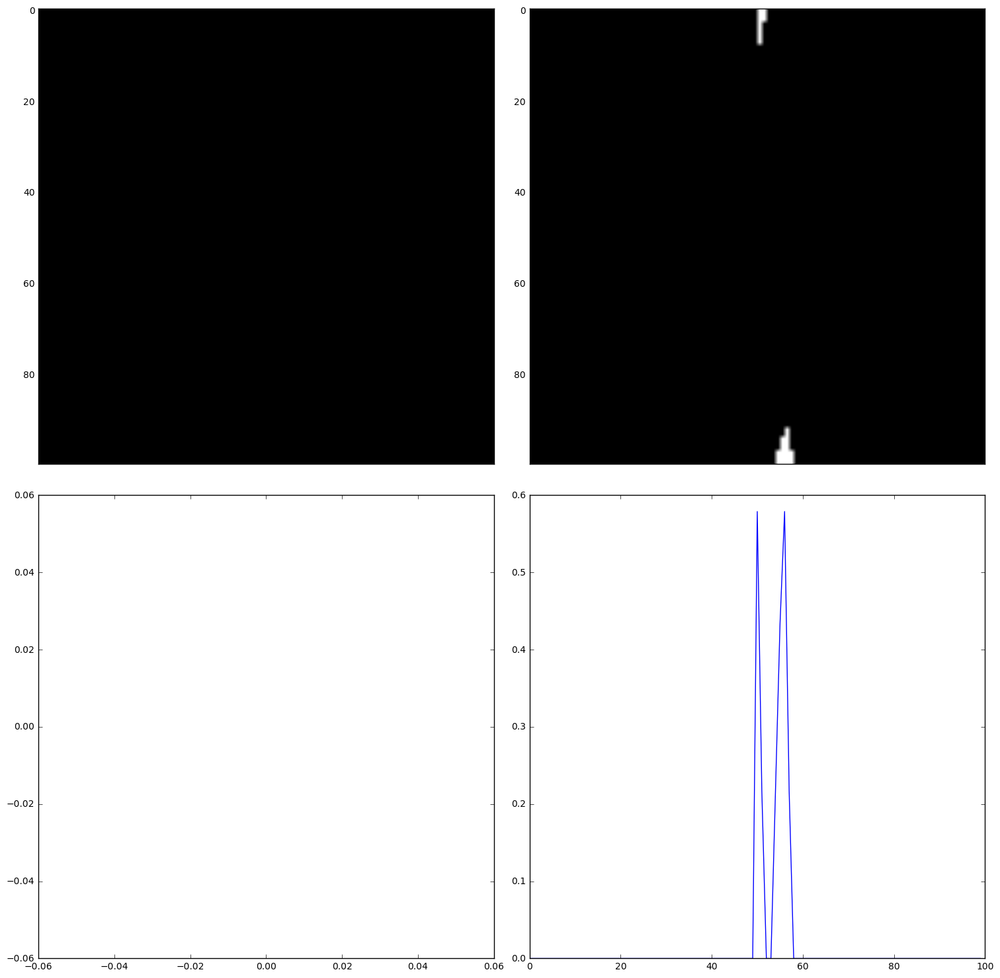

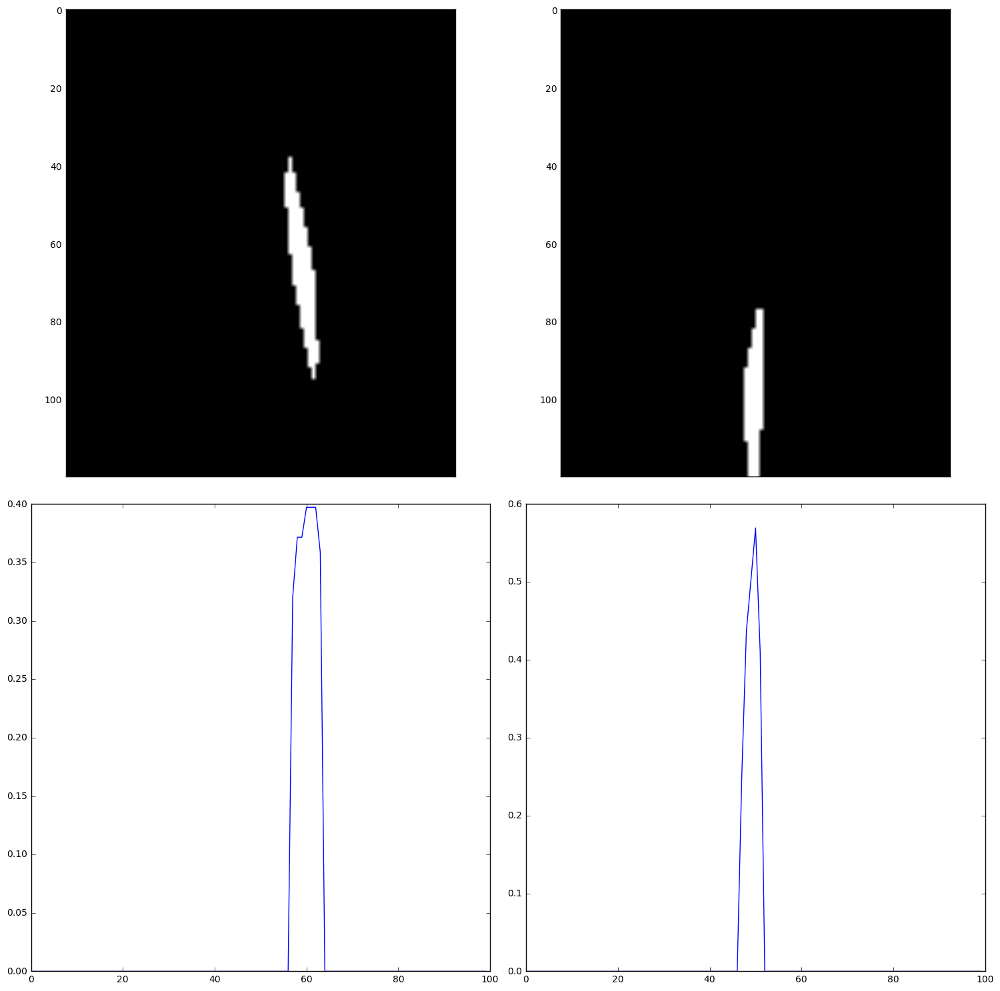

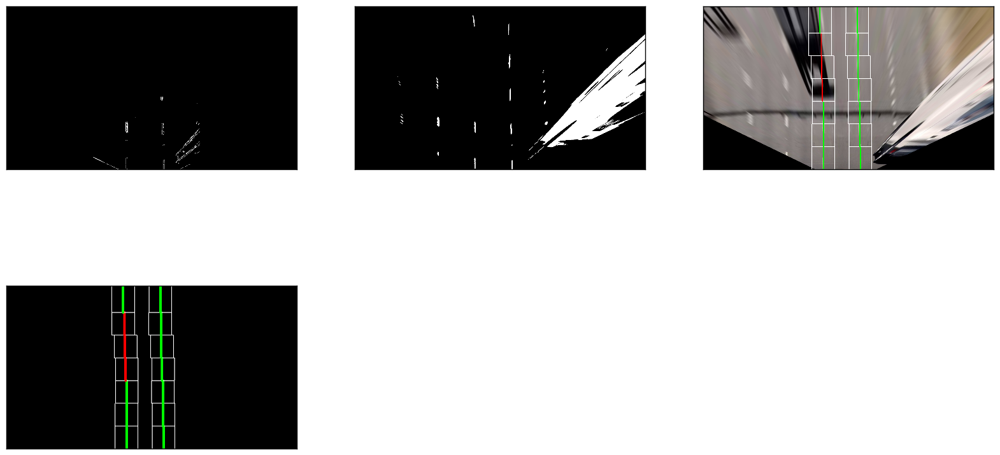

In [212]:
org = udimg1
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

pairs = get_peaks(sx, x//2)
# print(pairs)

# TODO: do something to ensure the pair selected
# is the very best before the following step
line_imgs, centroids = draw_lane_lines(sx, pairs[0][0], pairs[0][1], warp, True)
# plot_imgs(line_imgs[:-1])
# plot_imgs([line_imgs[-1]])

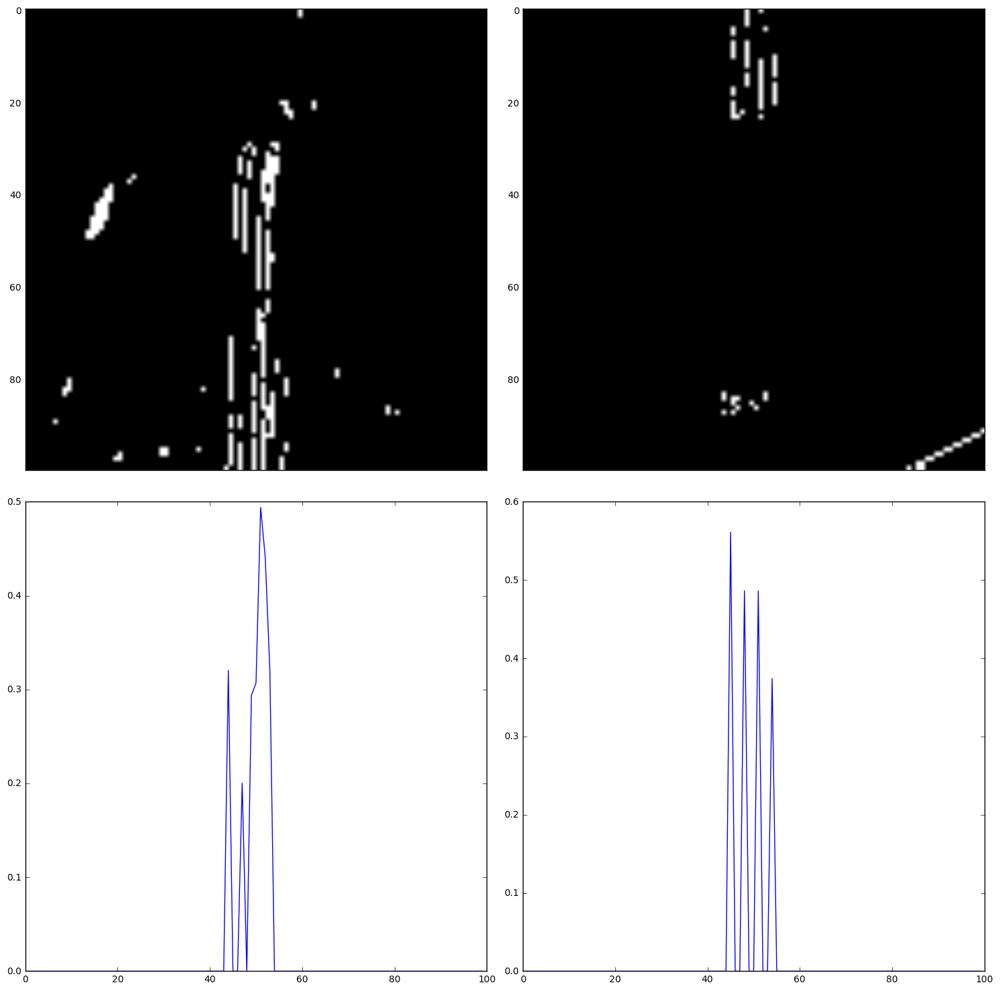

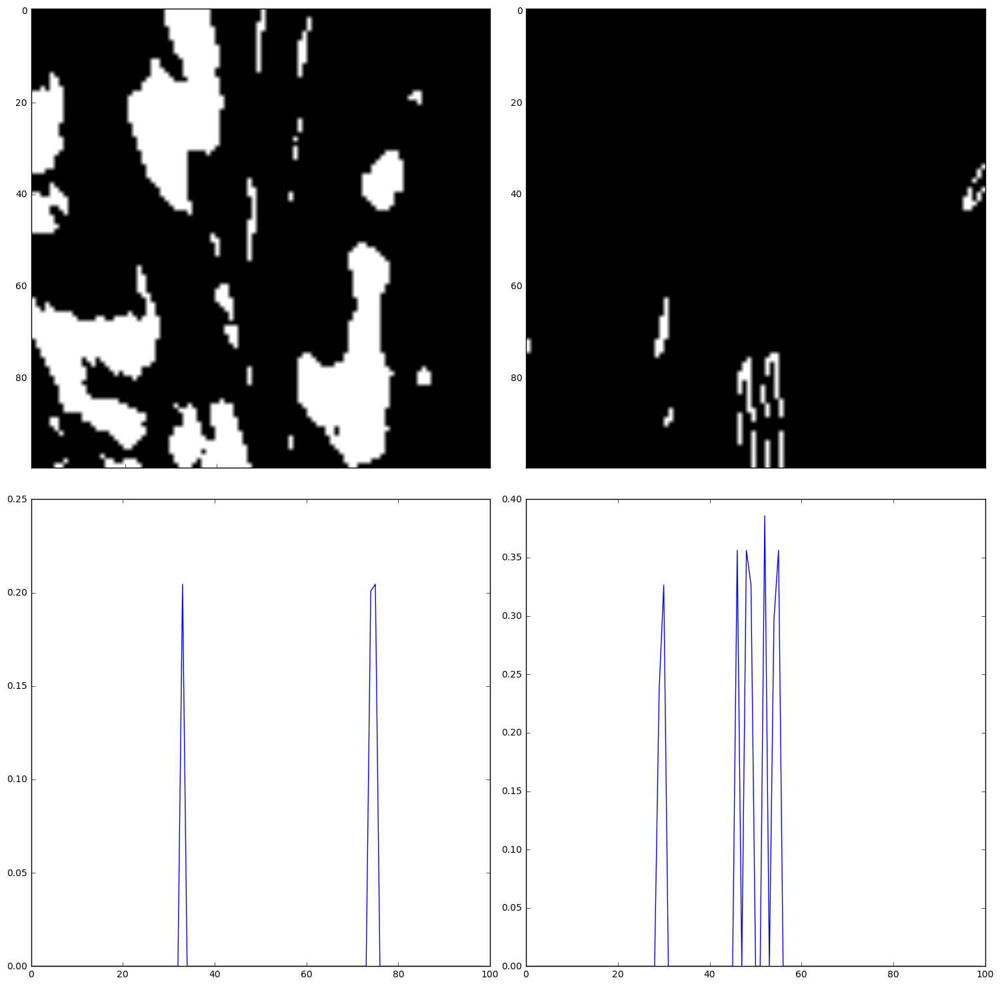

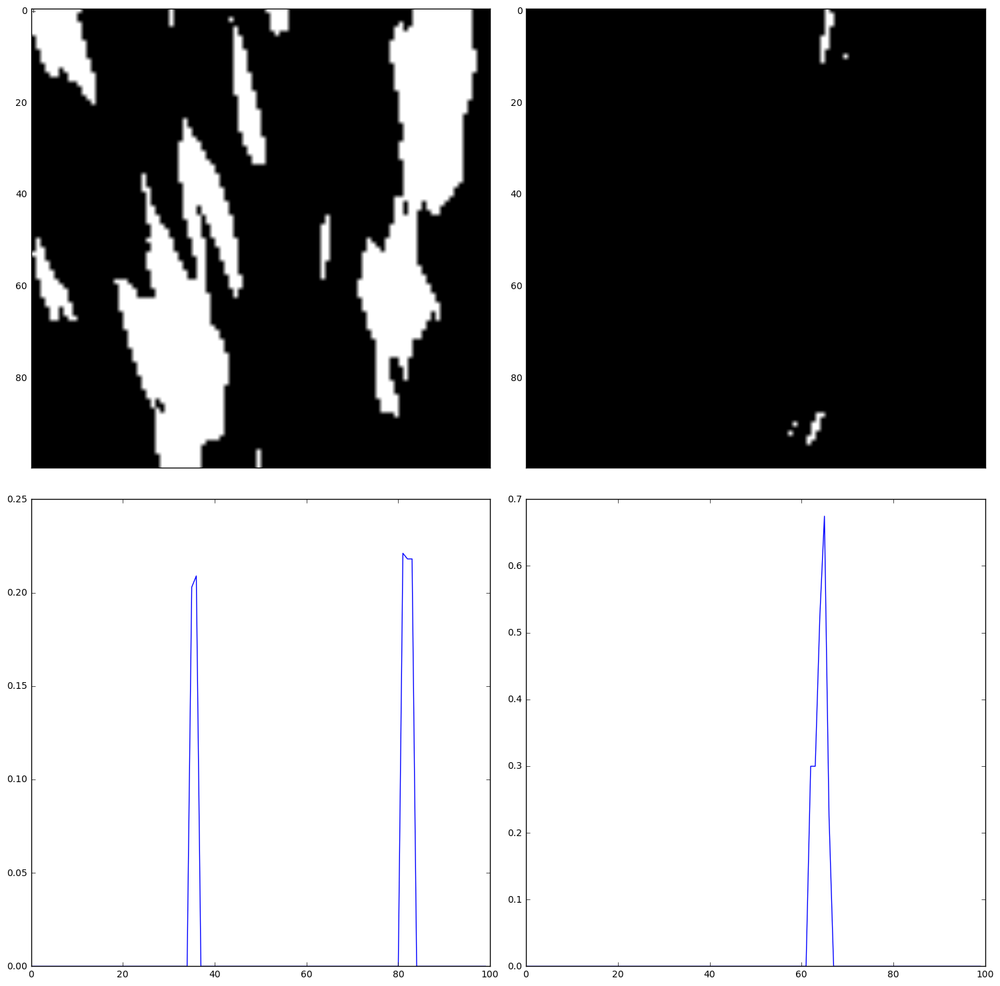

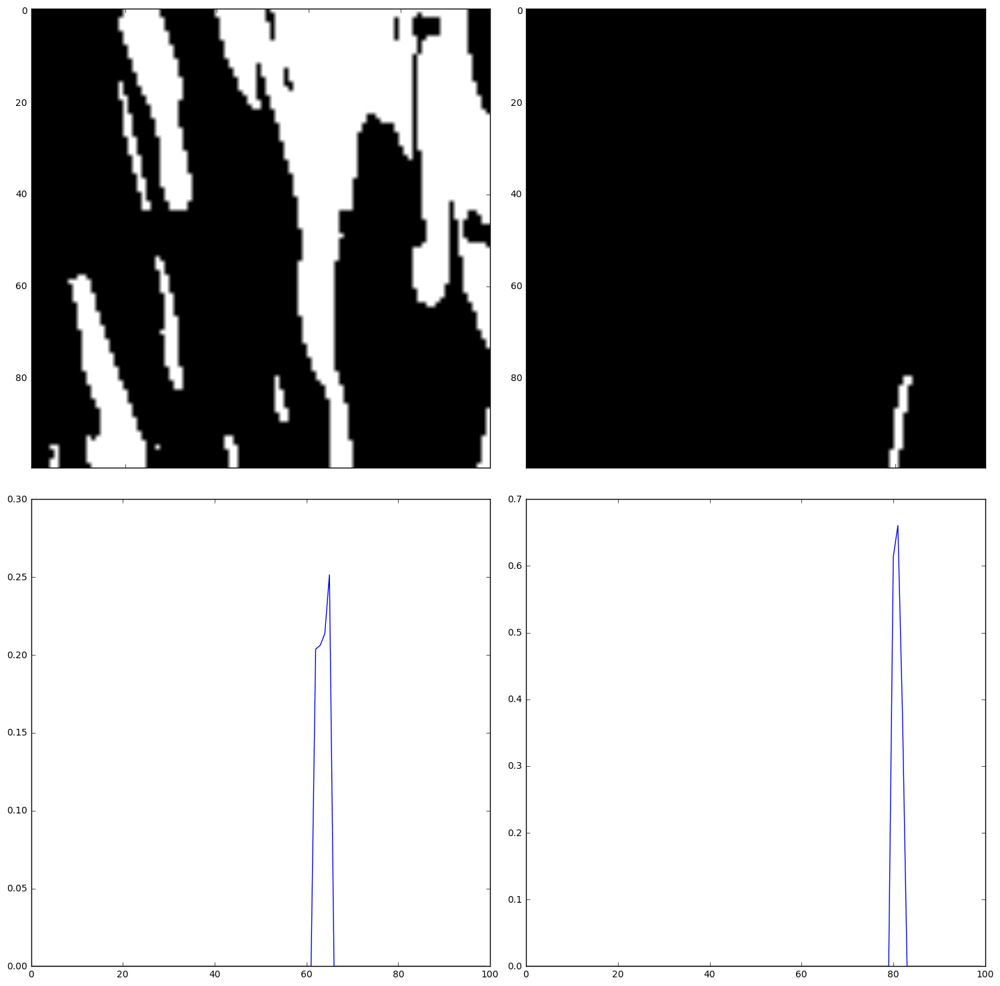

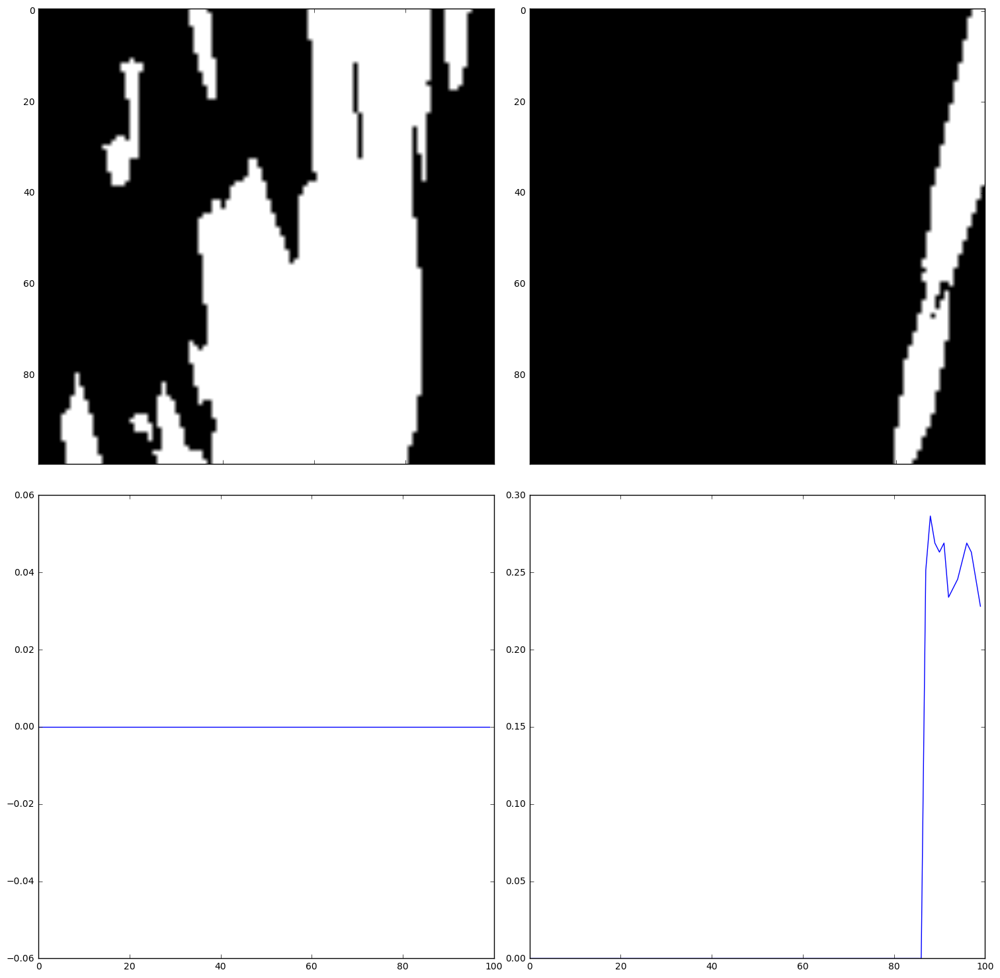

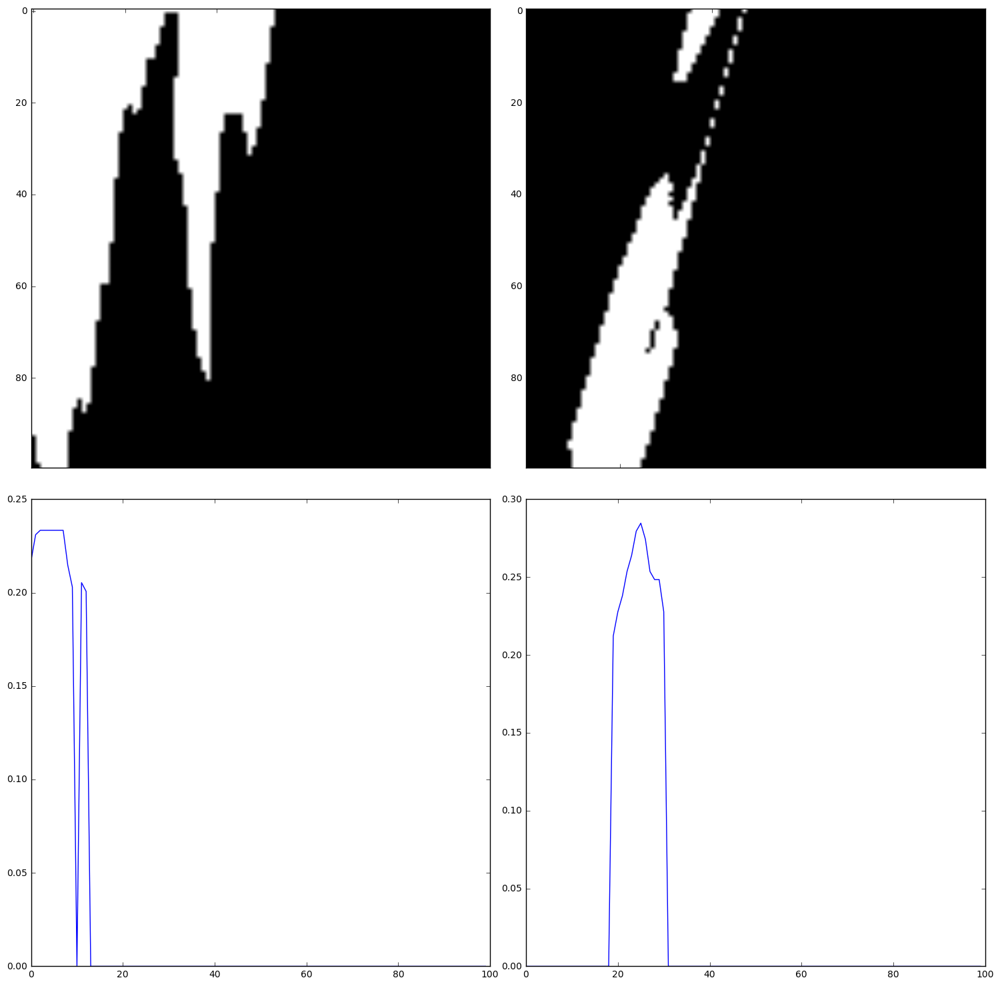

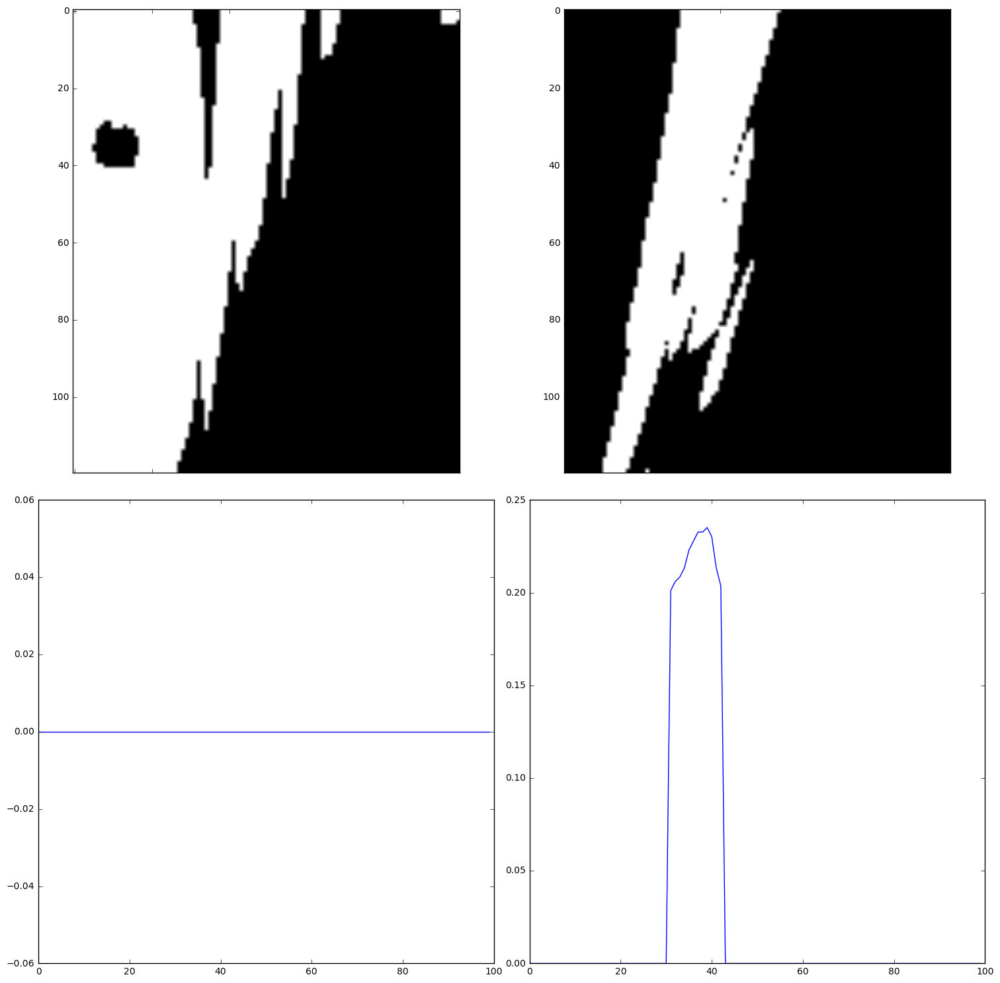

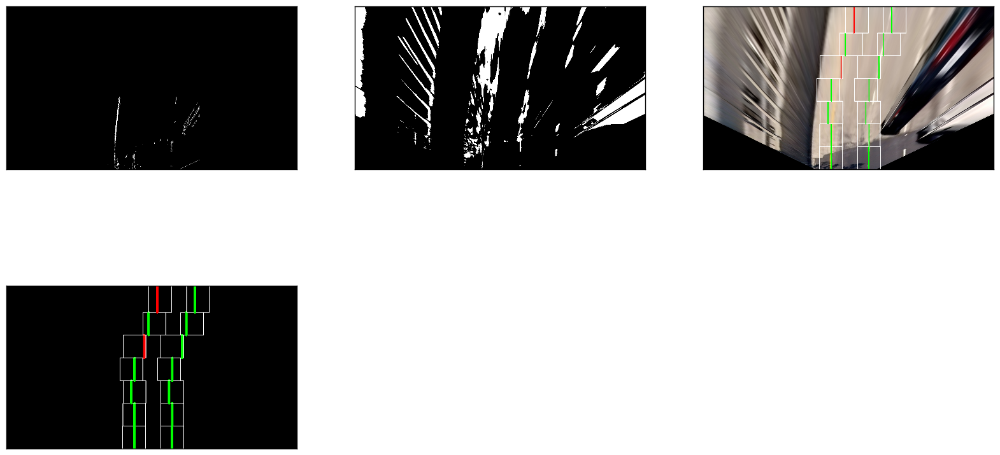

In [213]:
org = udimg2
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

pairs = get_peaks(sx, x//2)
# print(pairs)

# TODO: do something to ensure the pair selected
# is the very best before the following step
line_imgs, centroids = draw_lane_lines(sx, pairs[0][0], pairs[0][1], warp, True)
# plot_imgs(line_imgs[:-1])
# plot_imgs([line_imgs[-1]])

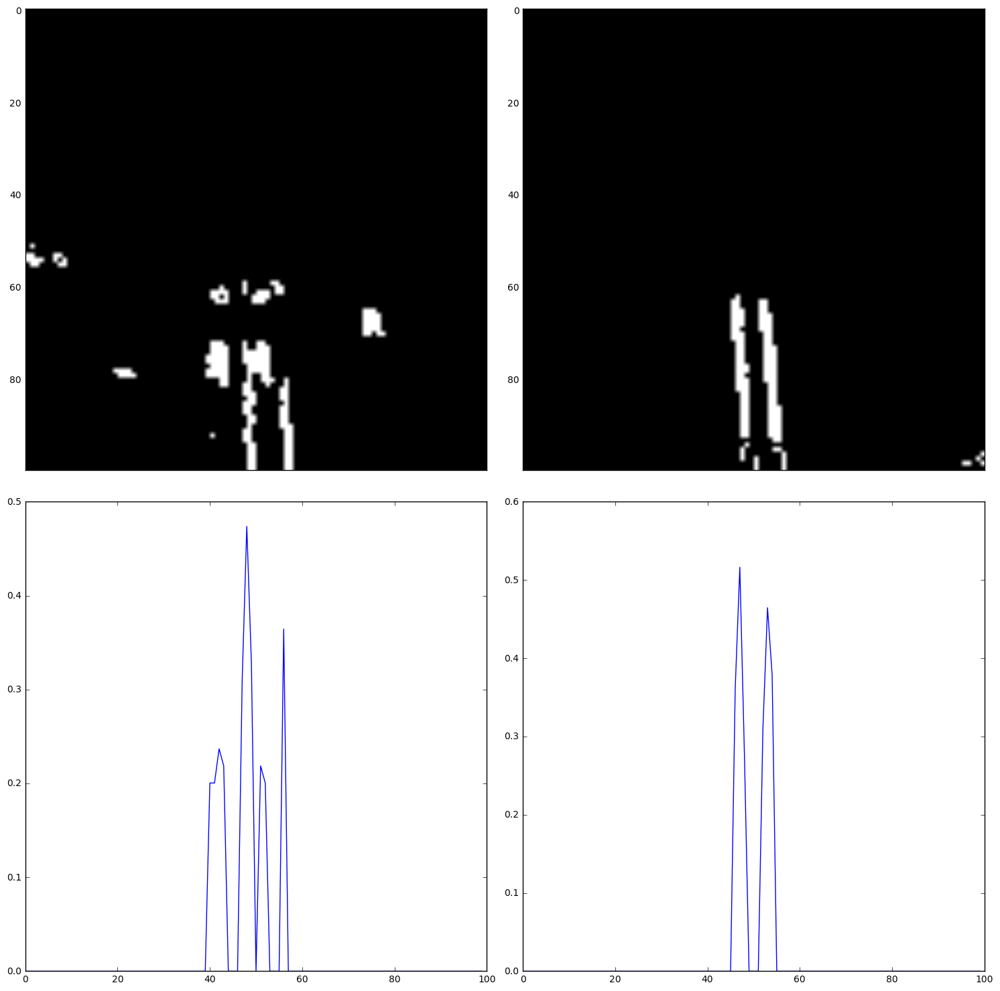

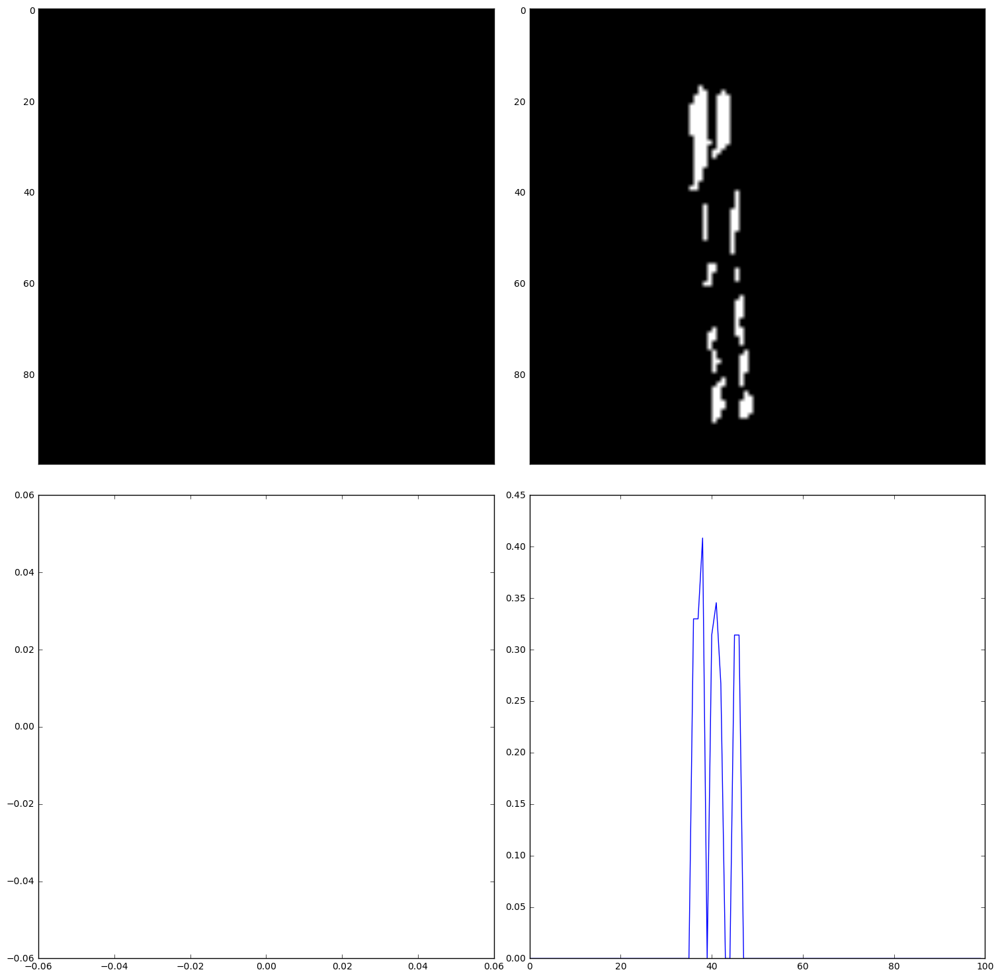

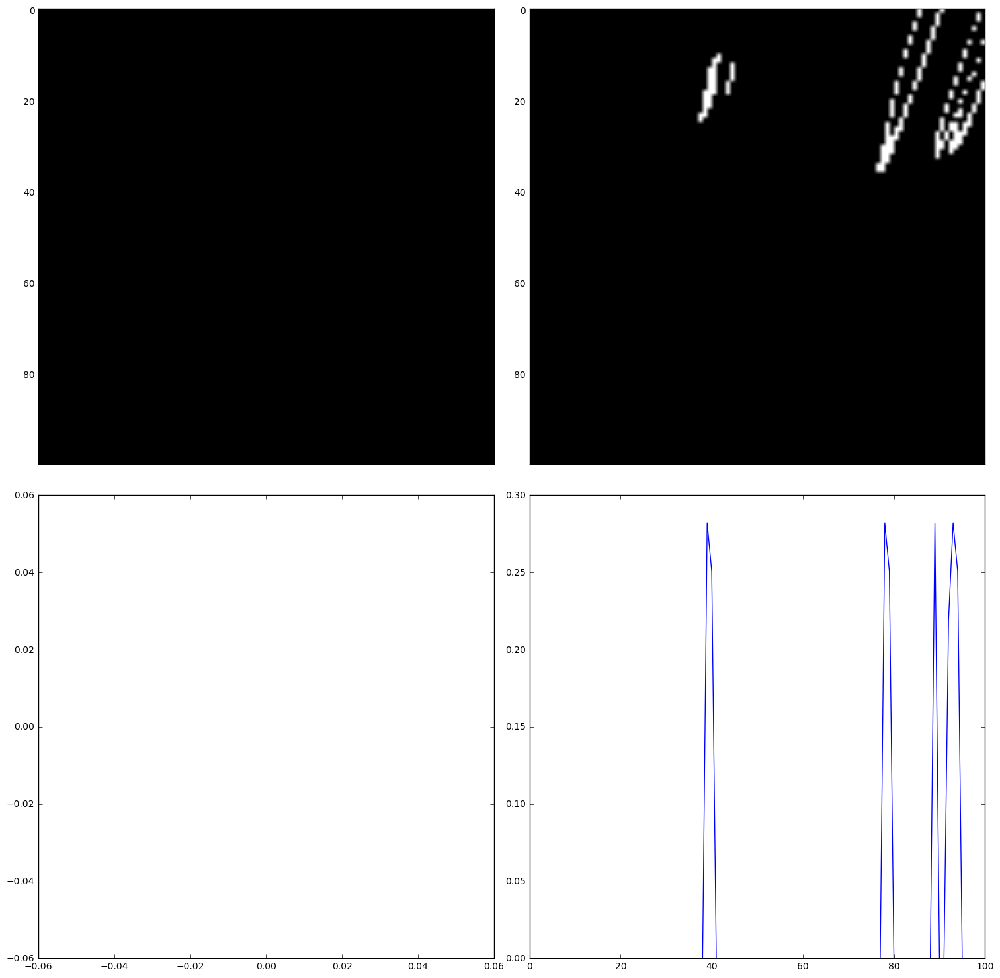

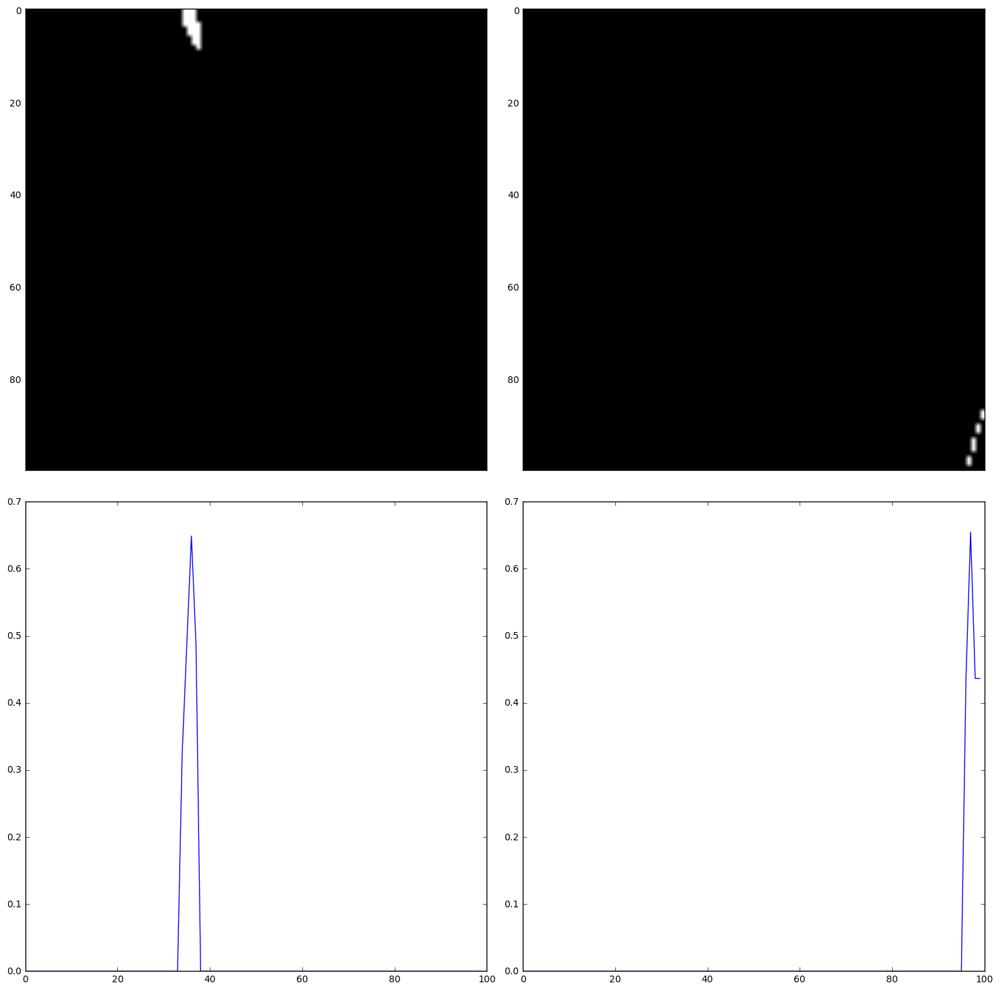

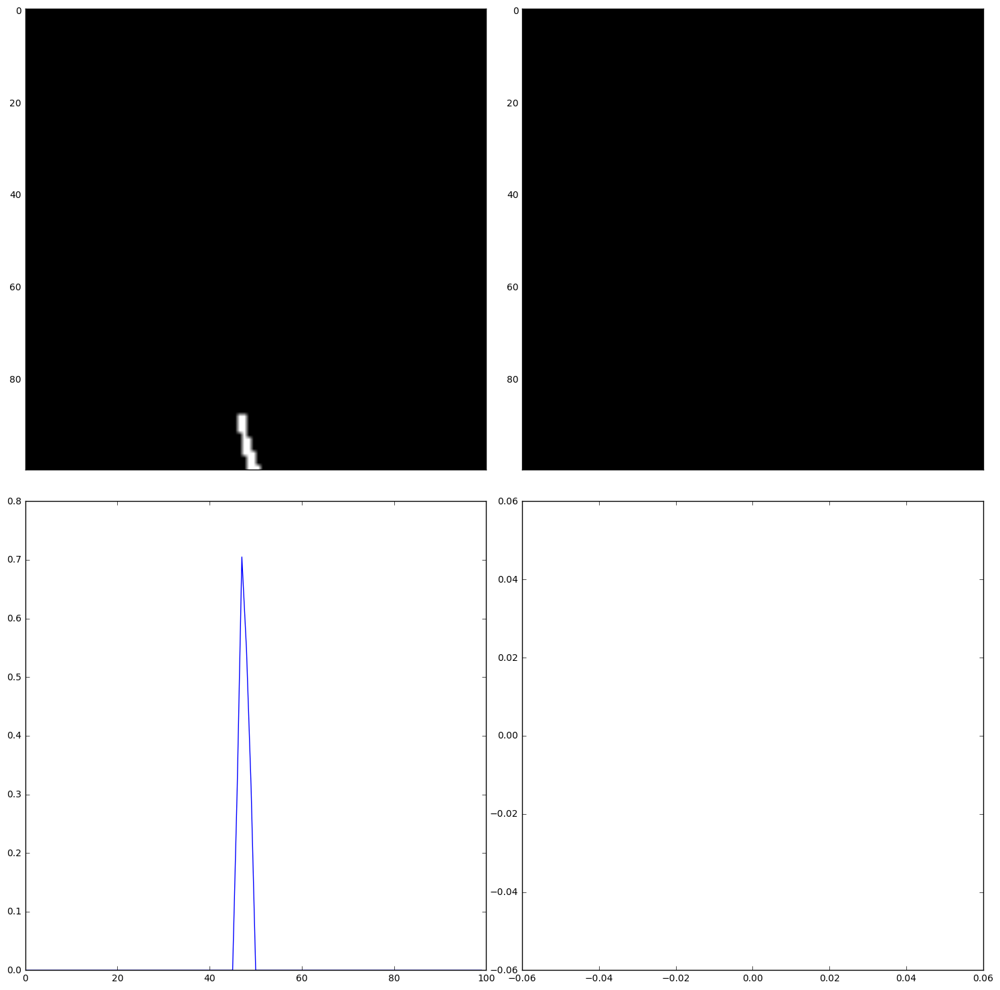

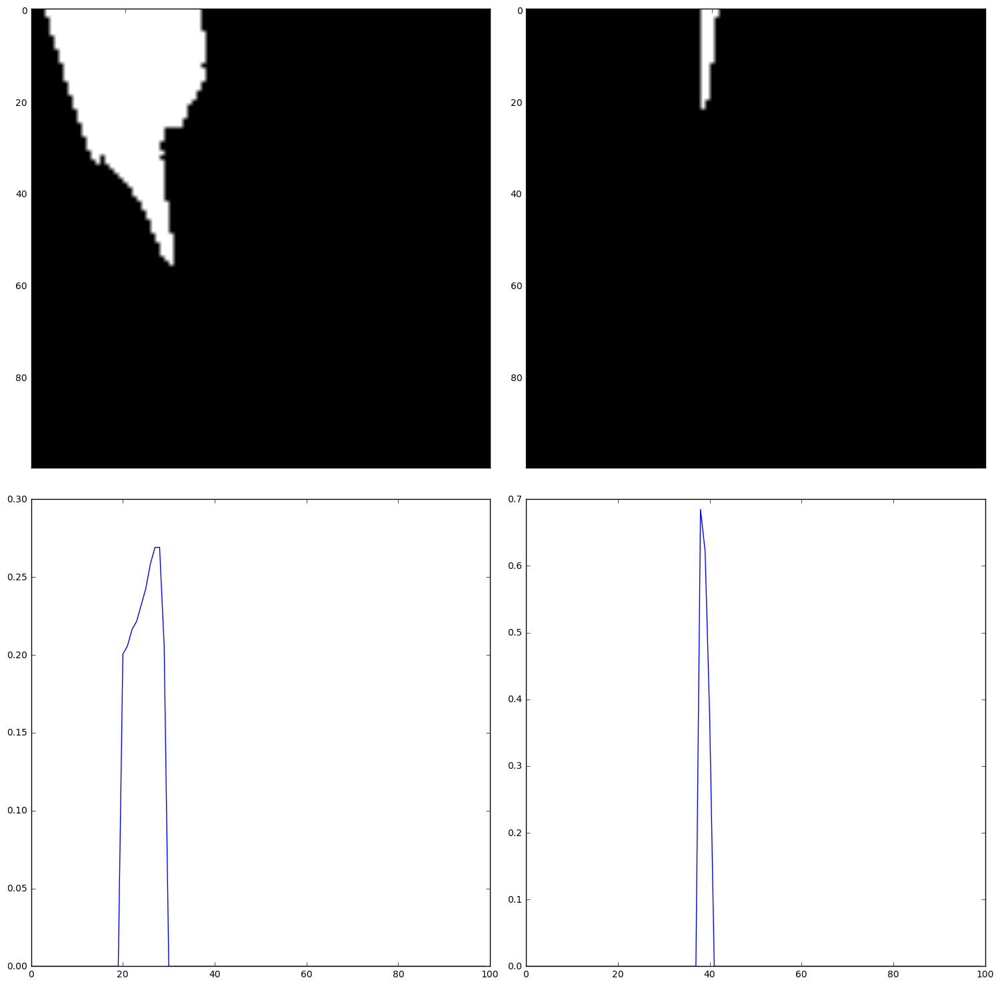

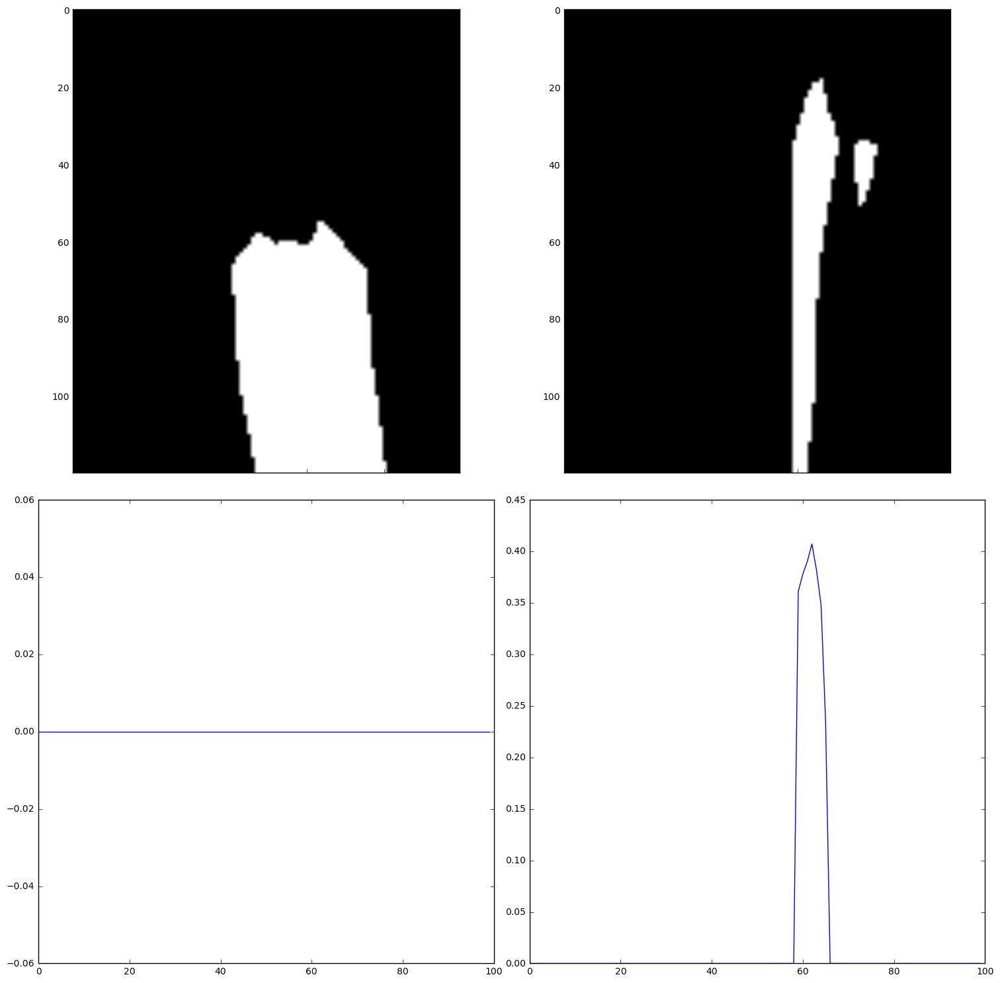

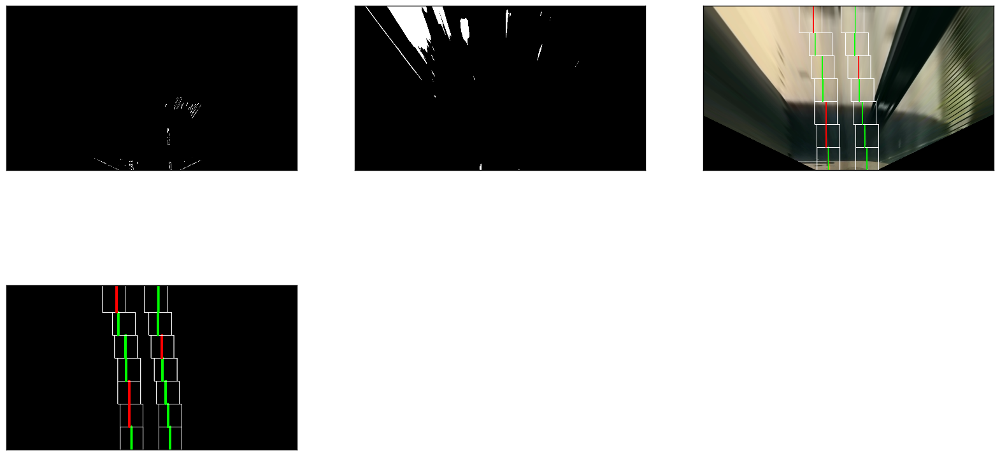

In [214]:
org = myimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

pairs = get_peaks(sx, x//2)
# print(pairs)

# TODO: do something to ensure the pair selected
# is the very best before the following step
line_imgs, centroids = draw_lane_lines(sx, pairs[0][0], pairs[0][1], warp, True)
# plot_imgs(line_imgs[:-1])
# plot_imgs([line_imgs[-1]])

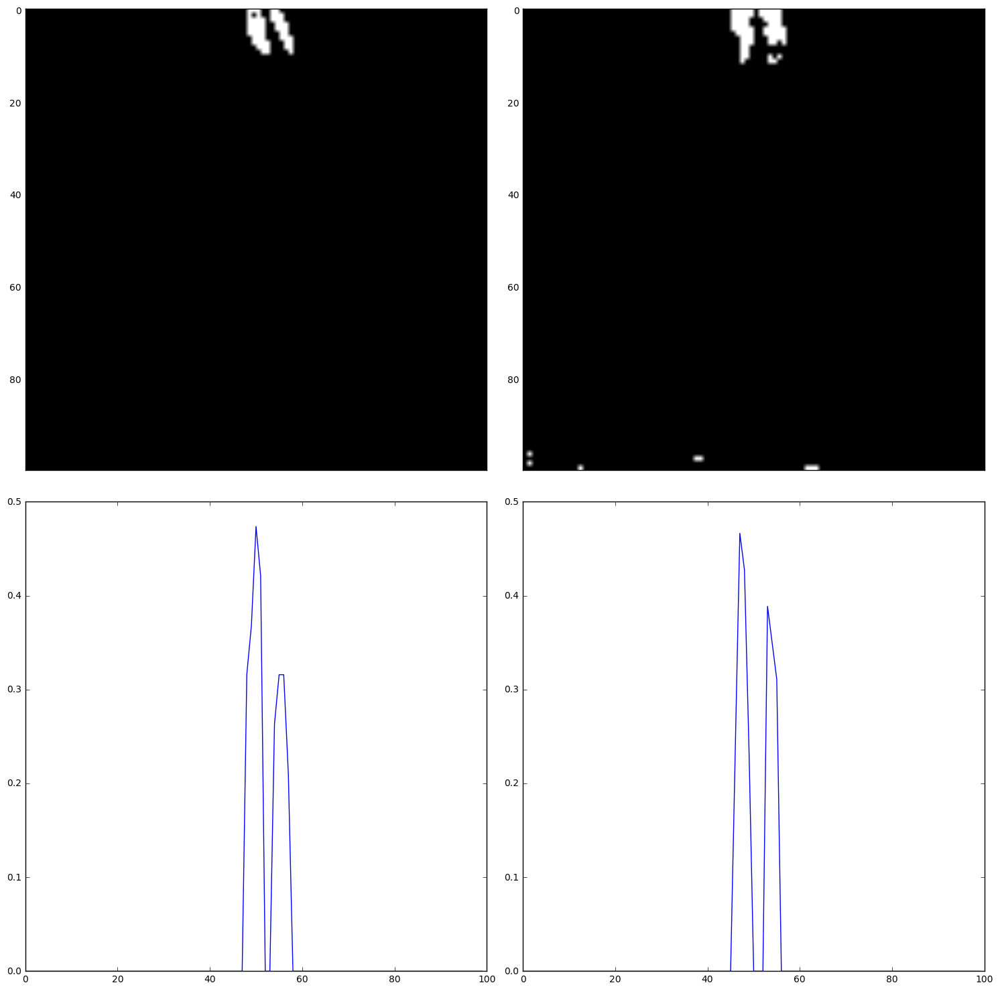

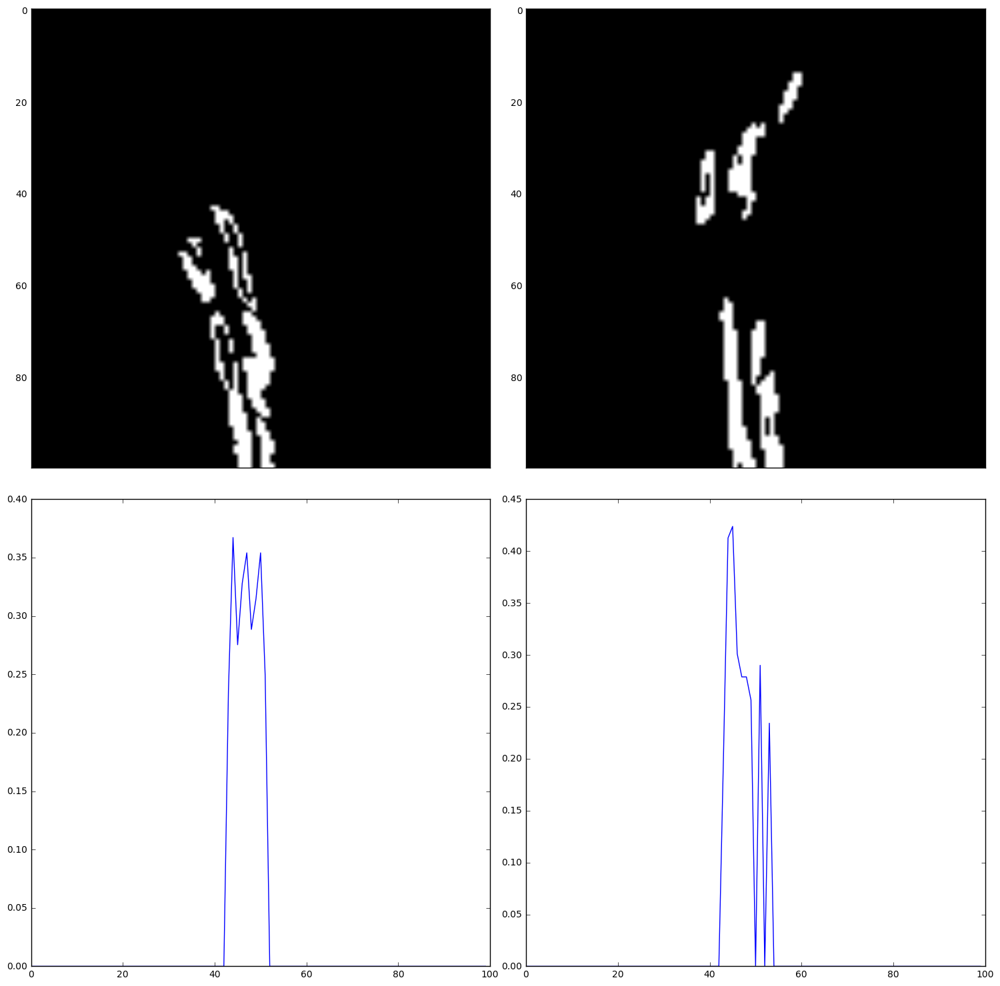

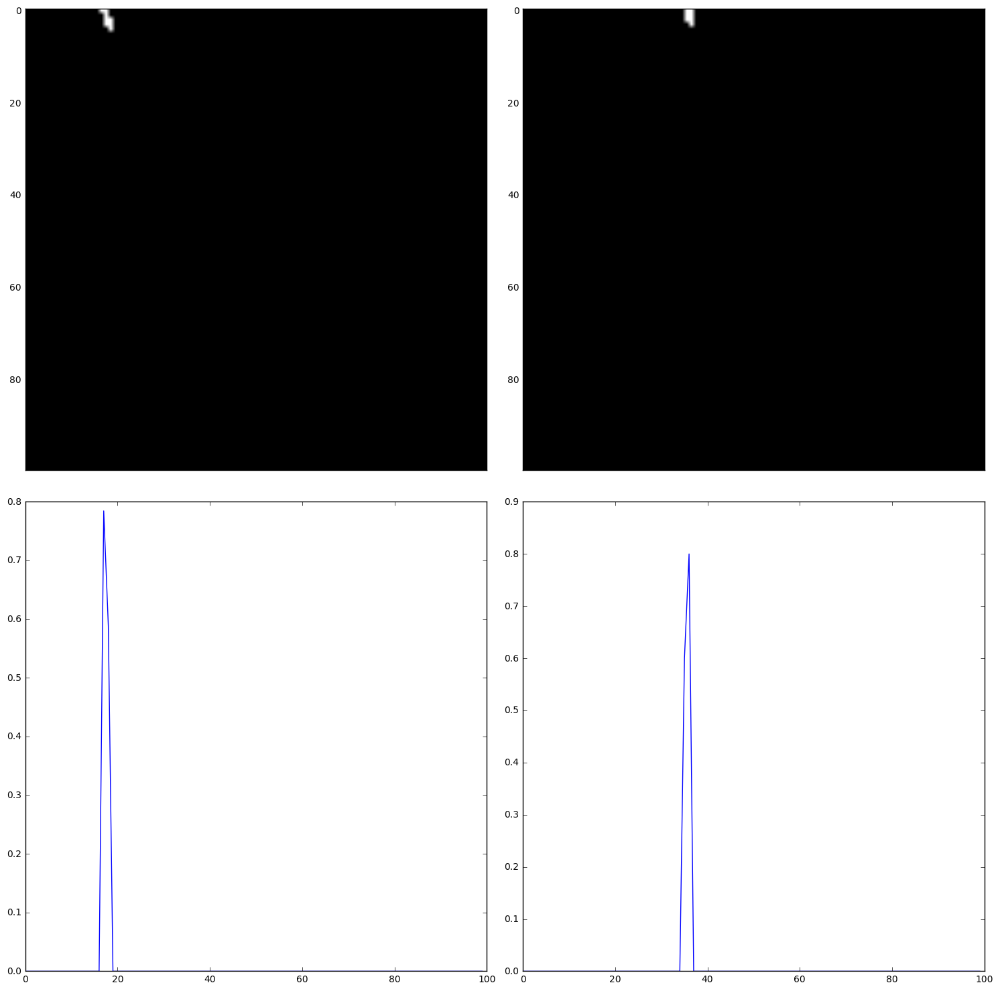

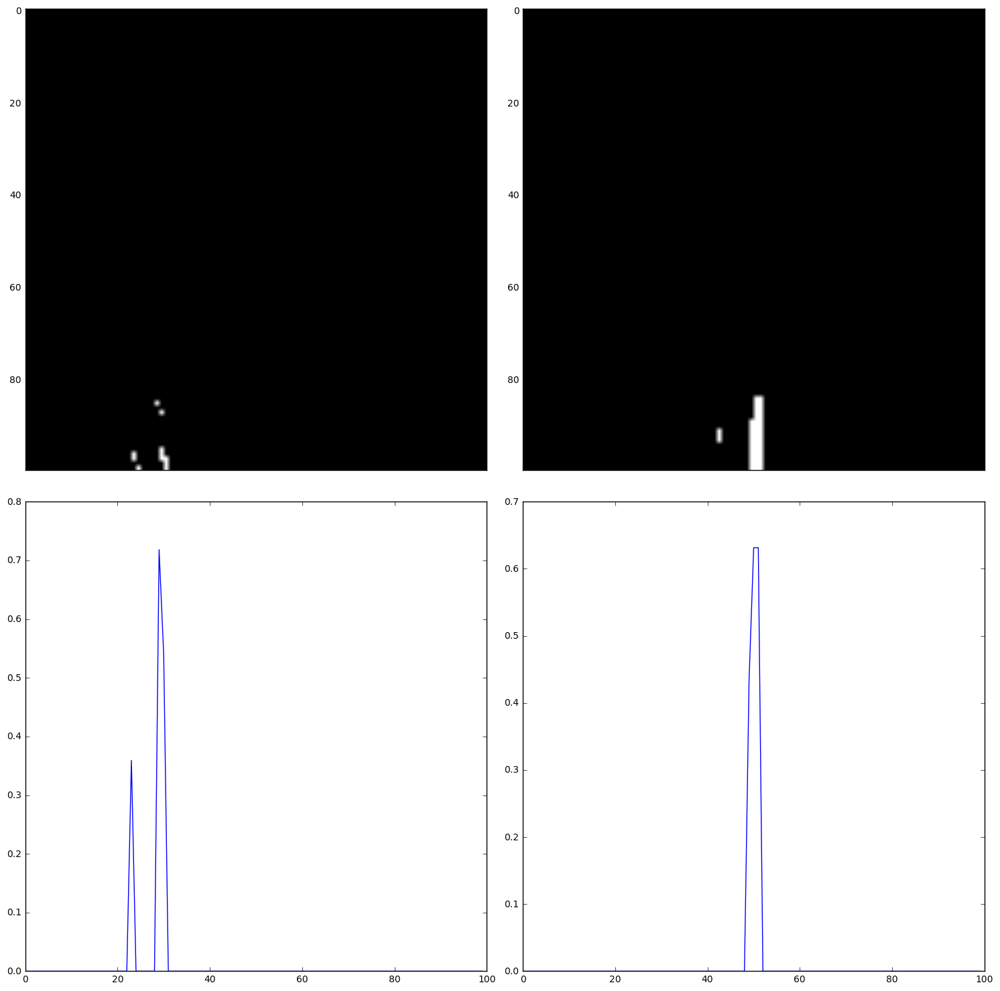

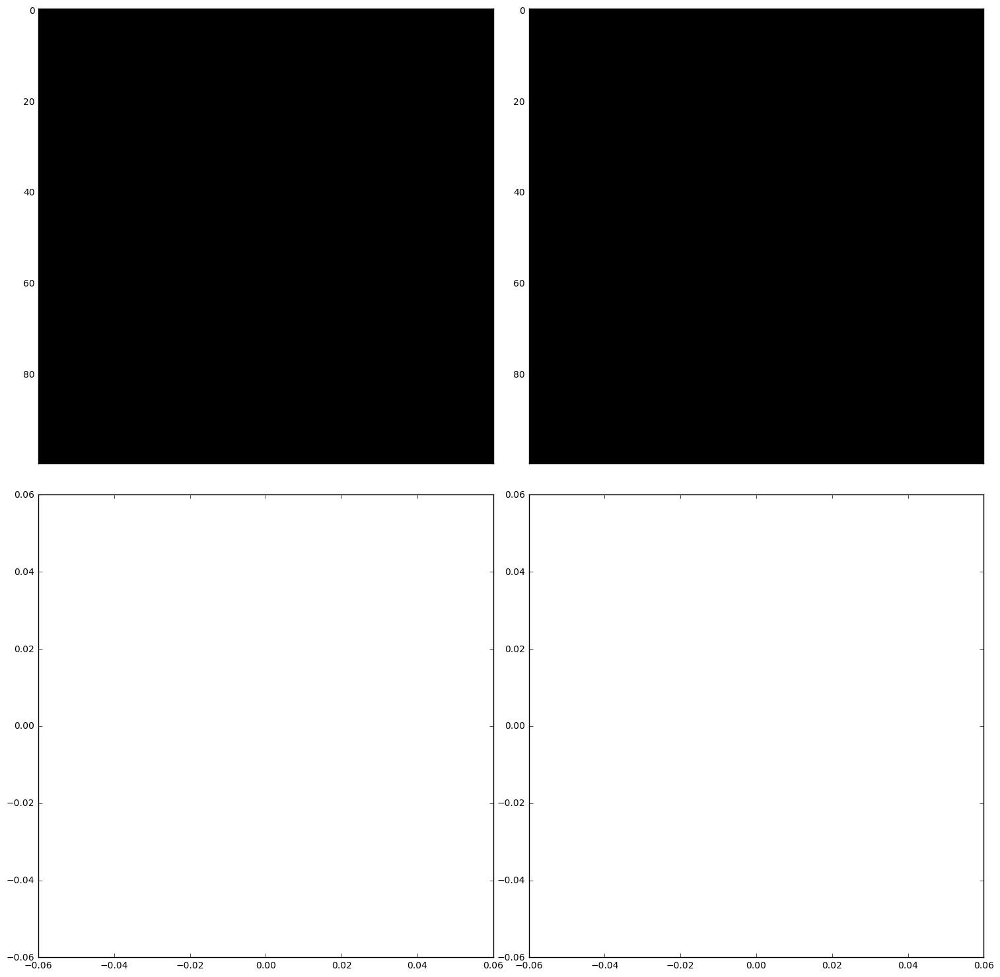

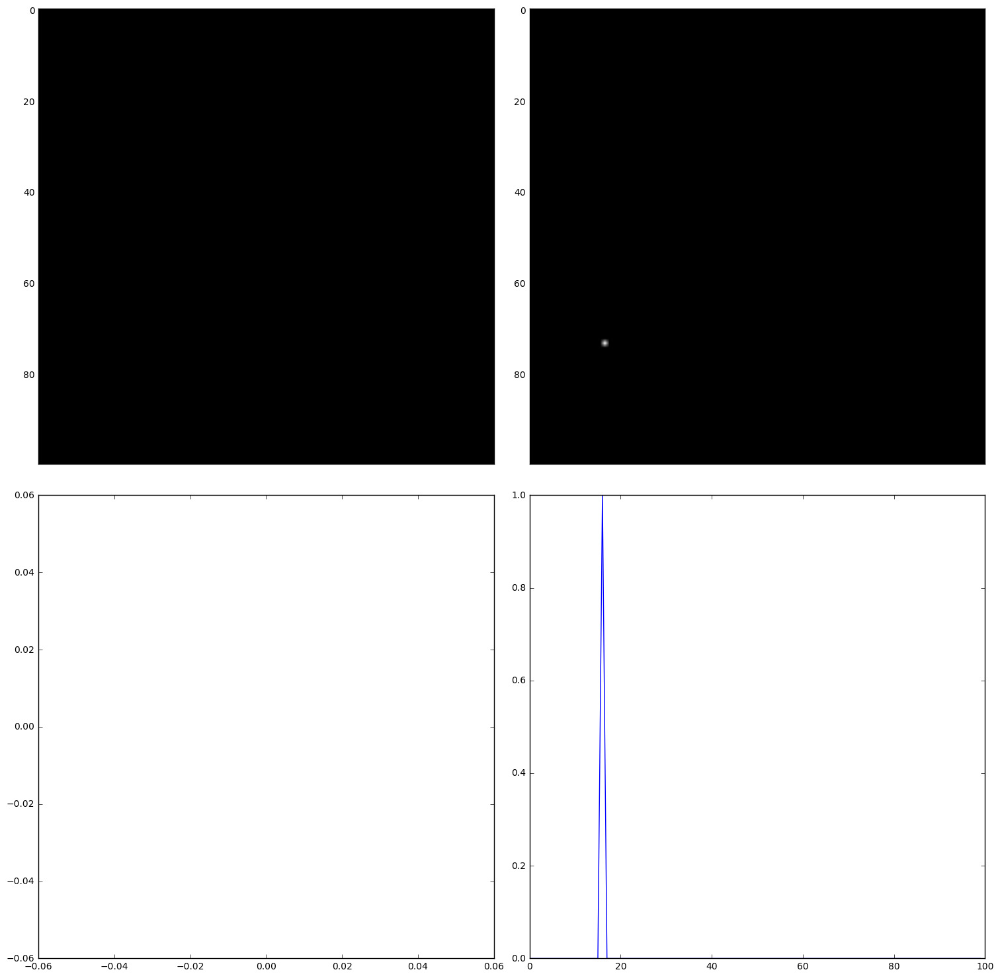

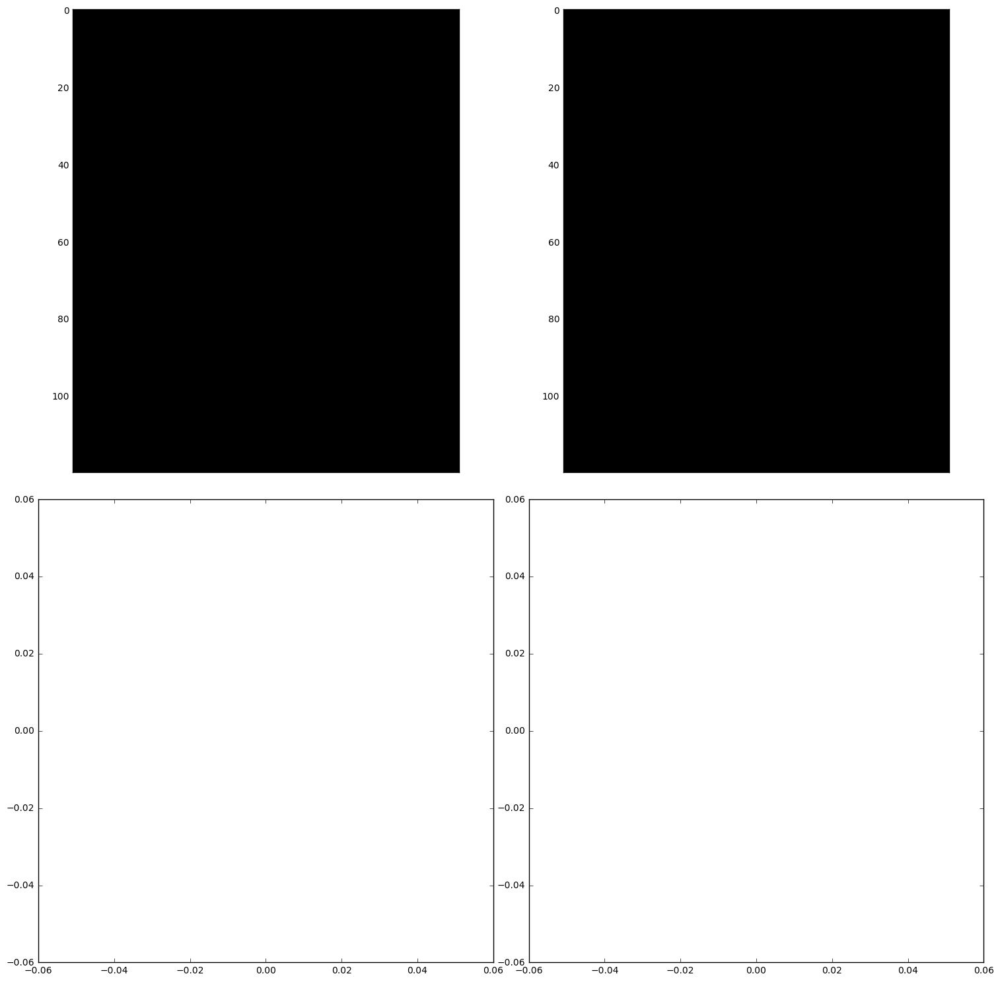

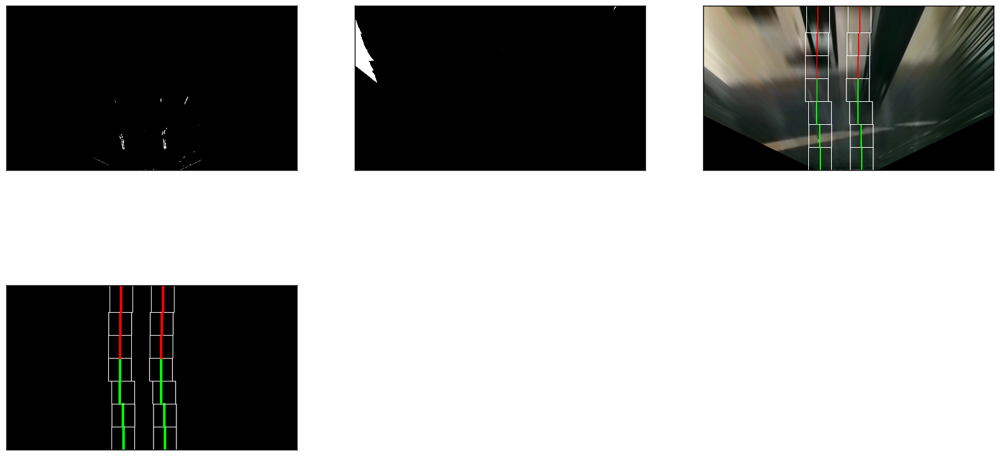

In [215]:
org = myimg2
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

pairs = get_peaks(sx, x//2)
# print(pairs)

# TODO: do something to ensure the pair selected
# is the very best before the following step
line_imgs, centroids = draw_lane_lines(sx, pairs[0][0], pairs[0][1], warp, True)
# plot_imgs(line_imgs[:-1])
# plot_imgs([line_imgs[-1]])

In [324]:
class VideoProcessing:
    def __init__(self):
        self.centroids = []
        self.raw_centroids = []
        self.lane_widths = []
        self.raw_lane_widths = []

    def calibrate_from_path(self, imshape, calibration_directory):
        objpoints, imgpoints, imgs = get_calibration_coef(calibration_directory)
        self.mtx, self.dist = self.calibrate(imshape, objpoints, imgpoints)
    
    def get_calibration_coef(self, cal_imgs, nx=9, ny=6, plot=False):
        objpoints = []
        imgpoints = []
        drawnimgs = []

        objp = np.zeros((nx*ny, 3), np.float32)
        objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

        fnames = glob.glob(cal_imgs)

        for fname in fnames:
            img = imread(fname)

            gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
            ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

            # if chessboard corners were not found, continue to next image
            if not ret:
                continue

            # save the points to calibrate later
            imgpoints.append(corners)
            objpoints.append(objp)

            # no need to waste cycles if do not want plotting
            if not plot:
                continue

            # draw points in the img and save a copy
            cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
            drawnimgs.append(img)
        return objpoints, imgpoints, drawnimgs

    def calibrate(self, img_shape, objpoints, imgpoints):
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
            objpoints, imgpoints, img_shape, None, None)
        return mtx, dist

    def undistort(self, img, mtx, dist):
        return cv2.undistort(img, mtx, dist, None, mtx)

    def cal_undistort(self, img, objpoints, imgpoints, mtx=None, dist=None):

        if mtx==None or dist==None:
            mtx, dist = self.calibrate(img.shape[0:2], objpoints, imgpoints)

        undist = self.undistort(img, mtx, dist)
        return undist, mtx, dist

    def get_perspective(self, img_size, src=None, dst=None, inv=False):
        x, y = img_size

        if src == None or dst == None:
            src = np.float32([
                    (180, 680), (595, 440), (685, 440), (1280, 680),
                ])    
            dst = np.float32([
                    (530, 720), (530, 0), (760, 0), (760, 720)
                ])

        return cv2.getPerspectiveTransform(src, dst) if not inv else cv2.getPerspectiveTransform(dst, src)


    def unwarp(self, img, mtx, dist):
        img_size = (img.shape[1], img.shape[0])    
        x, y = img_size

        src = np.float32([
                (180, 680), (595, 440), (685, 440), (1280, 680),
            ])    
        dst = np.float32([
                (530, 720), (530, 0), (760, 0), (760, 720)
            ])

        unwarpped, M = self.corners_unwarp(img, mtx, dist, src, dst)
        return unwarpped, M

    def corners_unwarp(self, img, mtx, dist, src=None, dst=None):
        img_size = (img.shape[1], img.shape[0])
        M = self.get_perspective(img_size, src, dst)
        warped = cv2.warpPerspective(img, M, img_size, flags = cv2.INTER_LINEAR)
        return warped, M
    
    def hls_select(self, img, selection='l', thresh=(0, 255)):
        # 1) Convert to HLS color space
        hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        H = hls[:,:,0]
        L = hls[:,:,1]
        S = hls[:,:,2]

        # 2) Apply a threshold to the S channel
        q = H if selection=='h' else L if selection=='l' else S
        binary = np.zeros_like(q)
        binary[(q > thresh[0]) & (q <= thresh[1])] = 1

        return binary
        
    def abs_sobel_thresh(self, img, orient='x', sobel_kernel=3, thresh=(0, 255)):

        gray = img

        # 1) Convert to grayscale
        if len(img.shape) == 3:
            gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

        # 2) Take the derivative in x or y given orient = 'x' or 'y'
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        sobel = sobelx if orient == 'x' else sobely

        # 3) Take the absolute value of the derivative or gradient
        abs_sobel = np.absolute(sobel)

        # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
        scale_factor = np.max(abs_sobel)/255 
        scaled_sobel = (abs_sobel/scale_factor).astype(np.uint8) 

        # 5) Create a mask of 1's where the scaled gradient magnitude 
                # is > thresh_min and < thresh_max
        binary = np.zeros_like(scaled_sobel)
        binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

        # 6) Return this mask as your binary_output image
        return binary

    def filter_yellow(self, img):
        img = cv2.GaussianBlur(img, (1, 1), 0)
        hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        mask = cv2.inRange(hsv, 
                           (10, 80, 170), 
                           (40, 225, 225))
        return mask
    
    def filter_white(self, img):
        mask = cv2.inRange(img, 
                           (165, 165, 175), 
                           (255, 255, 255))
        return mask

    def get_peaks(self, img, middle):
        histogram = np.sum(img[600:,:], axis=0)
        histogram[histogram < 15] = 0
        peaks = np.array(find_peaks_cwt(histogram, np.arange(15, 30)))

        #print(peaks)
        lefts = np.sort(peaks[peaks < middle])[::-1].astype(int)
        rights = np.sort(peaks[peaks > middle]).astype(int)

        possible_pairs = []
        dist = (100, 170)
        for left in lefts:
            lowest = left + dist[0]
            highest = left + dist[1]
            #print('lowest', lowest)
            #print('highest', highest)
            subset_possible = peaks[peaks > lowest]
            #print('remove lows', subset_possible)
            subset_possible = subset_possible[subset_possible < highest]
            #print('remove highs', subset_possible)
            if len(subset_possible) > 0:
                # get first possible
                possible_pairs.append((left, subset_possible[0]))

        # print(possible_pairs)
        for pair in possible_pairs:
            #cv2.line(img, (pair[0], 0), (pair[0], y), 1, 1)
            #cv2.line(img, (pair[1], 0), (pair[1], y), 1, 1)
            break
        #cv2.line(sx, (middle, 0), (middle, y), 1, 1)
        
        """
        f, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 15))
        f.tight_layout()
        ax1.imshow(img, cmap='gray')
        plt.setp(ax1.get_xticklabels(), visible=False)
        ax2 = plt.subplot(212, sharex=ax1)
        plt.plot(histogram)
        plt.show()
        """

        return possible_pairs


    def detect_binary_lines(self, img):
        s = self.hls_select(img, selection='s', thresh=(100, 255))
        g = self.abs_sobel_thresh(s, orient='x', sobel_kernel=3, thresh=(80, 255))

        y = self.filter_yellow(img)
        w = self.filter_white(img)
        return np.array((y | w | g), dtype=np.uint8)

    def peakdet(self, v, delta, x = None):
        """
        Converted from MATLAB script at http://billauer.co.il/peakdet.html

        Returns two arrays

        function [maxtab, mintab]=peakdet(v, delta, x)
        %PEAKDET Detect peaks in a vector
        %        [MAXTAB, MINTAB] = PEAKDET(V, DELTA) finds the local
        %        maxima and minima ("peaks") in the vector V.
        %        MAXTAB and MINTAB consists of two columns. Column 1
        %        contains indices in V, and column 2 the found values.
        %      
        %        With [MAXTAB, MINTAB] = PEAKDET(V, DELTA, X) the indices
        %        in MAXTAB and MINTAB are replaced with the corresponding
        %        X-values.
        %
        %        A point is considered a maximum peak if it has the maximal
        %        value, and was preceded (to the left) by a value lower by
        %        DELTA.

        % Eli Billauer, 3.4.05 (Explicitly not copyrighted).
        % This function is released to the public domain; Any use is allowed.
        % Usage: maxtab, mintab = peakdet(series,.3)
        """
        maxtab = []
        mintab = []

        if x is None:
            x = arange(len(v))

        v = asarray(v)

        if len(v) != len(x):
            sys.exit('Input vectors v and x must have same length')

        if not isscalar(delta):
            sys.exit('Input argument delta must be a scalar')

        if delta <= 0:
            sys.exit('Input argument delta must be positive')

        mn, mx = Inf, -Inf
        mnpos, mxpos = NaN, NaN

        lookformax = True

        for i in arange(len(v)):
            this = v[i]
            if this > mx:
                mx = this
                mxpos = x[i]
            if this < mn:
                mn = this
                mnpos = x[i]

            if lookformax:
                if this < mx-delta:
                    maxtab.append((mxpos, mx))
                    mn = this
                    mnpos = x[i]
                    lookformax = False
            else:
                if this > mn+delta:
                    mintab.append((mnpos, mn))
                    mx = this
                    mxpos = x[i]
                    lookformax = True

        return array(maxtab), array(mintab)

    def get_window_values(self, img, starty, endy, startx, endx, 
                          thresh=(0.2, 5, 10)):
        #print(starty, endy, startx, endx, thresh)
        #print(np.max((starty,0)), np.max((startx,0)))
        window_img = img[np.max((starty,0)):endy,np.max((startx,0)):endx]
        hist = np.sum(window_img, axis=0)
        hist = hist / np.linalg.norm(hist)
        hist[hist < thresh[0]] = 0
        peaks = np.array(find_peaks_cwt(hist, np.arange(
                    thresh[1], thresh[2])))
        return window_img, hist, peaks

    def get_peak_displacement(self, x, my_peaks, other_peaks):

        if len(my_peaks) == 0 and len(other_peaks) == 1:
            return other_peaks[0]
        if len(my_peaks) > 0:
            idx = (np.abs(my_peaks-x)).argmin()
            return my_peaks[idx]
        return x

    def draw_window_outline(self, img, window_left_x, window_right_x, 
                            bottom_y, upper_y, col=((255,)*3), 
                            thickness=2):
        cv2.line(img, (window_left_x, bottom_y), 
                 (window_left_x, upper_y), col, thickness)
        cv2.line(img, (window_right_x, bottom_y), 
                 (window_right_x, upper_y), col, thickness)
        cv2.line(img, (window_left_x, upper_y), 
                 (window_right_x, upper_y), col, thickness)
        cv2.line(img, (window_left_x, bottom_y), 
                 (window_right_x, bottom_y), col, thickness)
        return img


    def clamp_values_to_lane_width(self, left_window_values, 
                                   right_window_values, max_lane_width_diff):
        
        left_window_x, xl, wxl, window_last_wxl = left_window_values
        right_window_x, xr, wxr, window_last_wxr = right_window_values

        """
        [670 670 678 678 654 659 669 662 662 670 667 672 676 674 675 675 675 674
         675 674 675 650 661 652 665 665 672 673 673 672 669 641 653 653 656 660
         660 661 638 638 637 637 636 645 648 647 647 647 646 648]
        [828 829 830 832 808 809 819 810 808 818 821 825 823 824 824 823 823 822
         822 822 826 801 813 805 817 817 820 820 821 821 824 799 811 814 815 816
         817 817 794 792 792 792 791 800 799 798 798 796 796 797]
        [158 159 152 154 154 150 150 148 146 148 154 153 147 150 149 148 148 148
         147 148 151 151 152 153 152 152 148 147 148 149 155 158 158 161 159 156
         157 156 156 154 155 155 155 155 151 151 151 149 150 149]
        151
        26
        153
        2
        668 821 
        print()        
        print(wxl, wxr)
        print(window_last_wxl)
        print(window_last_wxr)
        print(window_last_wxr - window_last_wxl)

        """       
        median_lane_width = int(np.median(window_last_wxr - window_last_wxl))
        #print(median_lane_width)
        #print(max_lane_width_diff)
        new_lane_width = wxr - wxl
        #print(new_lane_width)
        
        lane_width_diff = abs(median_lane_width - new_lane_width)
        #print(lane_width_diff)

        last_wxl = np.mean(window_last_wxl[:5])
        last_wxr = np.mean(window_last_wxr[:5])
        if lane_width_diff > max_lane_width_diff:
            if abs(last_wxr - wxr) < abs(last_wxl - wxl):
                # inverse the values
                wxl = wxr - median_lane_width
            else:
                wxr = wxl + median_lane_width
        #print(int(wxl), int(wxr))
        return int(wxl), int(wxr)

    def draw_middle_lines(self, img, left, right, bottom, top, 
                          color_left, color_right, thickness):

        cv2.line(img, (left, bottom), 
                 (left, top), color_left, thickness)
        cv2.line(img, (right, bottom), 
                 (right, top), color_right, thickness)
        return img
    
    def smooth_out_xs(self, window_last_wxl, window_last_wxr, wxl, wxr, wy):

        # wxl, wxr = self.smooth_out_xs(window_last_wxl, window_last_wxr, wxl, wxr, xl, xr)
        rate = 0.5 if wy > 400 else 0.9 if wy > 200 else 0.1

        lpart1 = wxl*rate
        lpart2 = np.mean(window_last_wxl[:4])*(1.-rate)/2.
        lpart3 = np.mean(window_last_wxl[4:])*(1.-rate)/2.
        new_wxl = int(lpart1 + lpart2 + lpart3)
        
        rpart1 = wxr*rate
        rpart2 = np.mean(window_last_wxr[:4])*(1.-rate)/2
        rpart3 = np.mean(window_last_wxr[4:])*(1.-rate)/2
        new_wxr = int(rpart1 + rpart2 + rpart3)

        return new_wxl, new_wxr
    
    def draw_lane_lines_from_bottom_to_top(self, img, wx, ws, col):
        dark = np.zeros_like(img).astype(np.uint8)
        color_dark = np.dstack((dark, dark, dark))
        color_dark_mark = np.dstack((dark, dark, dark))

        bina = self.detect_binary_lines(col)
        bina[bina != 255] = 0
        bina[bina == 255] = 1

        y, x = img.shape
        wxl, wxr = wx
        wys, wxs = ws
        lane_width = wxr - wxl

        centroids = []
        raw_centroids = []
        bottom_windows = np.arange(y, 20, -50)
        window_sizes = np.linspace(wxs, 100, len(bottom_windows)).astype(int)
        max_line_width_diffs = np.linspace(10, 30, len(bottom_windows)).astype(int)
  
        for i in range(len(bottom_windows)):
            wy = bottom_windows[i]
            wxs = window_sizes[i]
            max_line_width_diff = max_line_width_diffs[i]

            left_window_left_x, left_window_right_x = wxl-wxs//2, wxl+wxs//2
            right_window_left_x, right_window_right_x = wxr-wxs//2, wxr+wxs//2
            upper_y, bottom_y = (0 if wy == 70 else wy-wys), wy

            left_window_img, left_hist, left_peaks = self.get_window_values(
                img, upper_y, bottom_y, left_window_left_x, left_window_right_x)

            right_window_img, right_hist, right_peaks = self.get_window_values(
                img, upper_y, bottom_y, right_window_left_x, right_window_right_x)

            if len(left_peaks) == 0:
                left_window_img, left_hist, left_peaks = self.get_window_values(
                    bina, upper_y, bottom_y, left_window_left_x, left_window_right_x)

            if len(right_peaks) == 0:
                right_window_img, right_hist, right_peaks = self.get_window_values(
                    bina, upper_y, bottom_y, right_window_left_x, right_window_right_x)

            xl = self.get_peak_displacement(wxs//2, left_peaks, right_peaks)
            xr = self.get_peak_displacement(wxs//2, right_peaks, left_peaks)

            color_left = (255,0,0) if len(left_peaks) == 0 else (0,255,0)
            color_right = (255,0,0) if len(right_peaks) == 0 else (0,255,0)
            
            # draw left window
            self.draw_window_outline(color_dark, left_window_left_x, 
                                     left_window_right_x, 
                                     bottom_y, upper_y, color_left)

            self.draw_window_outline(color_dark_mark, left_window_left_x, 
                                     left_window_right_x, 
                                     bottom_y, upper_y, color_left)

            # draw right windows
            self.draw_window_outline(color_dark, right_window_left_x, 
                                     right_window_right_x, 
                                     bottom_y, upper_y, color_right)

            self.draw_window_outline(color_dark_mark, right_window_left_x, 
                                     right_window_right_x, 
                                     bottom_y, upper_y, color_right)

            # calculate a default value
            raw_wxl = left_window_left_x + xl
            raw_wxr = right_window_left_x + xr
            raw_centroids.append((raw_wxl, raw_wxr, bottom_y))
            self.raw_lane_widths.append(abs(raw_wxr - raw_wxl))
            
            if len(self.raw_centroids) > 10:
                # smooth out the values before drawing to the middle
                window_last_centroids_left =  np.array(self.raw_centroids)[-10:][::-1][:,:,0]
                window_last_centroids_right =  np.array(self.raw_centroids)[-10:][::-1][:,:,1]
                window_last_wxl = window_last_centroids_left[:, i]
                window_last_wxr = window_last_centroids_right[:, i]
                smoothe_wxl, smoothe_wxr = self.smooth_out_xs(
                    window_last_wxl, window_last_wxr, raw_wxl, raw_wxr, wy)
            else:
                smoothe_wxl, smoothe_wxr = raw_wxl, raw_wxr
            
            if len(self.raw_centroids) > 50:
                # for now no clampling just a pass by
                window_last_centroids_left =  np.array(self.raw_centroids)[-50:][::-1][:,:,0]
                window_last_centroids_right =  np.array(self.raw_centroids)[-50:][::-1][:,:,1]
                window_last_wxl = window_last_centroids_left[:, i]
                window_last_wxr = window_last_centroids_right[:, i]
                clamped_wxl, clamped_wxr = self.clamp_values_to_lane_width(
                    (left_window_left_x, xl, smoothe_wxl, window_last_wxl), 
                    (right_window_left_x, xr, smoothe_wxr, window_last_wxr), 
                    max_line_width_diff)
            else:
                clamped_wxl, clamped_wxr = smoothe_wxl, smoothe_wxr
            
            wxl, wxr = clamped_wxl, clamped_wxr
            
            self.draw_middle_lines(
                color_dark_mark, wxl, wxr, bottom_y, 
                upper_y, color_left, color_right, 5)
            self.lane_widths.append(abs(wxr - wxl))
            centroids.append((wxl, wxr, bottom_y))

            if bottom_y > 0 and bottom_y < 420:
                data = np.array(centroids)
                l = data[:,0]
                r = data[:,1]
                y = data[:,2]

                nwind = bottom_y - 50
                coefsl = poly.polyfit(y, l, 2)
                coefsr = poly.polyfit(y, r, 2)
                """
                print('for', nwind)
                print('clamped')
                print(wxl, wxr)
                print(data)
                print(l,r,y)
                """
                wxl = int(poly.polyval(nwind, coefsl))
                wxr = int(poly.polyval(nwind, coefsr))
                
                #print('fitted')
                #print(wxl, wxr)

            if len(self.raw_lane_widths) < 25:
                # create a buffer first
                return [img, bina, col, color_dark_mark, color_dark], ""

        self.raw_centroids.append(raw_centroids)
        self.centroids.append(centroids)
        return [img, bina, col, color_dark_mark, color_dark], ""

    def process_img(self, org):
        org = np.copy(org)
        und = undistort(org, self.mtx, self.dist)
        warp, M = unwarp(und, self.mtx, self.dist)
        sx = self.abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

        y, x = warp.shape[:2]
        sx[:,:380] = 0
        sx[:,850:] = 0
        sx[:400,:] = 0

        median_lane = np.median(self.lane_widths)
        if len(self.lane_widths) < 25:
            ws = (50, 150)
            wx = (int(x//2 - ws[1]//2), int(x//2 + ws[1]//2))
        elif len(self.lane_widths) < 100:
            ws = (50, 140)
            wx = (int(x//2 - median_lane//2), int(x//2 + median_lane//2))
        elif len(self.lane_widths) < 500:
            ws = (50, 130)
            wx = (int(x//2 - median_lane//2), int(x//2 + median_lane//2))
        elif len(self.lane_widths) < 1000:
            ws = (50, 100)
            wx = (int(x//2 - median_lane//2), int(x//2 + median_lane//2))
        elif len(self.lane_widths) < 10000:
            ws = (50, 70)
            wx = (int(x//2 - median_lane//2), int(x//2 + median_lane//2))
        else:
            ws = (50, 50)
            wx = (int(x//2 - median_lane//2), int(x//2 + median_lane//2))
        
        line_imgs, msg = self.draw_lane_lines_from_bottom_to_top(sx, wx, ws, warp)
        if len(self.centroids) == 0:
            return org
        centroids = self.centroids[-1]

        ###### plot lanes
        data = np.array(centroids)
        l = data[:,0]
        r = data[:,1]
        y = data[:,2]

        ypoints = np.arange(720)
        coefsl = poly.polyfit(y, l, 2)
        ffitl = poly.polyval(ypoints, coefsl)

        coefsr = poly.polyfit(y, r, 2)
        ffitr = poly.polyval(ypoints, coefsr)
        
        ######## detect curvature
        y_eval = np.max(y)//2
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meteres per pixel in x dimension

        left_fit_cr = np.polyfit(y*ym_per_pix, l*xm_per_pix, 2)
        right_fit_cr = np.polyfit(y*ym_per_pix, r*xm_per_pix, 2)

        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) \
                                     /np.absolute(2*left_fit_cr[0])

        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) \
                                        /np.absolute(2*right_fit_cr[0])

        average_curvature = np.mean((left_curverad, right_curverad))
        curvature_info = "curvature = {:.0f}m".format(average_curvature)
        
        ######### detect shift
        left_bottom_x = ffitl[-1]
        right_bottom_x = ffitr[-1]
        lane_center = (left_bottom_x + right_bottom_x)/2.0
        car_center = x/2.0
        shift = (car_center - lane_center) * xm_per_pix
        if shift > 0:
            # right
            shift_info = '     {:.2f}m ---|'.format(abs(shift))
        else:
            # left
            shift_info =  '|--- {:.2f}m     '.format(abs(shift))
        #print(curvature_info)
        #print(shift_info)        
        
        # Recast the x and y points into usable format for cv2.fillPoly()

        pts_left = np.array([np.transpose(np.vstack([ffitl, ypoints]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([ffitr, ypoints])))])
        pts = np.hstack((pts_left, pts_right))

        short, binary, color, color_dark_mark, color_dark = line_imgs
        # polyarea = np.zeros_like(line_imgs[-1])
        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_dark, np.int_([pts]), (0,0,255))
        
        ############# warp image back
        img_size = (und.shape[1], und.shape[0])    
        Minv = get_perspective(img_size, inv=True)
        overlay = cv2.warpPerspective(color_dark, Minv, img_size)

        # Combine the result with the original image
        result = cv2.addWeighted(und, 1, overlay, 0.8, 0)
        short[short == 1] = 255
        short = np.dstack((short, short, short))
        
        binary[binary == 1] = 255
        binary = np.dstack((binary, binary, binary))
        
        short = cv2.addWeighted(short, 1, color_dark_mark, 0.7, 0)
        binary = cv2.addWeighted(binary, 1, color_dark_mark, 0.7, 0)
        color = cv2.addWeighted(color, 1, color_dark_mark, 0.7, 0)

        short = imresize(short, 0.3)
        binary = imresize(binary, 0.3)
        color = imresize(color, 0.3)
        
        dwx, dwy = 384, 216
        result[0:dwy,0:dwx] = short
        result[0:dwy,dwx:dwx*2] = binary
        result[0:dwy,dwx*2:dwx*3] = color

        # result[0:dwy,1280-dwx:1280] = short
        # result[dwy:dwy*2,1280-dwx:1280] = binary
        # result[dwy*2:dwy*3,1280-dwx:1280] = color
        font = cv2.FONT_HERSHEY_SIMPLEX

        cv2.putText(result, curvature_info, (500,600), font, 1,(255,255,255),2)
        cv2.putText(result, shift_info, (500,650), font, 1,(255,255,255),2)
        # cv2.putText(result, debug_info, (500,500), font, 1,(255,255,255),2)

        return result

In [325]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'ud_cal/calibration*.jpg')

clip = VideoFileClip('ud_videos/project_video.mp4')
output_path = 'ud_videos/project_video_out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video ud_videos/project_video_out.mp4
[MoviePy] Writing video ud_videos/project_video_out.mp4















  0%|          | 0/1261 [00:00<?, ?it/s]












  0%|          | 2/1261 [00:00<01:45, 11.94it/s]












  0%|          | 4/1261 [00:00<01:46, 11.81it/s]












  0%|          | 6/1261 [00:00<01:46, 11.81it/s]












  1%|          | 8/1261 [00:00<01:46, 11.80it/s]












  1%|          | 10/1261 [00:00<01:48, 11.56it/s]












  1%|          | 12/1261 [00:01<01:49, 11.39it/s]












  1%|          | 14/1261 [00:01<01:48, 11.46it/s]












  1%|▏         | 16/1261 [00:01<01:46, 11.72it/s]












  1%|▏         | 18/1261 [00:01<01:44, 11.94it/s]












  2%|▏         | 20/1261 [00:01<01:43, 11.94it/s]












  2%|▏         | 22/1261 [00:01<01:42, 12.09it/s]












  2%|▏         | 24/1261 [00:02<02:05,  9.88it/s]












  2%|▏         | 26/1261 [00:02<02:39,  7.76it/s]












  2%|▏         | 27/1261 [00:02<03:12,  6.41it/s]












  2%|▏         | 28/1261 [00:03<03:59,  5.14it/s]












  2%|▏  

[MoviePy] Done.
[MoviePy] >>>> Video ready: ud_videos/project_video_out.mp4 

CPU times: user 24min 55s, sys: 8.09 s, total: 25min 4s
Wall time: 7min 51s


In [326]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_path))

In [245]:
cenarr = np.array(vp.centroids) 
print(cenarr[-10:][:,:,2][:,i])

[670 670 670 670 670 670 670 670 670 670]


In [327]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'ud_cal/calibration*.jpg')

clip = VideoFileClip('ud_videos/challenge_video.mp4')
output_path = 'ud_videos/challenge_video_out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video ud_videos/challenge_video_out.mp4
[MoviePy] Writing video ud_videos/challenge_video_out.mp4















  0%|          | 0/485 [00:00<?, ?it/s]












  0%|          | 2/485 [00:00<00:44, 10.91it/s]












  1%|          | 4/485 [00:00<00:42, 11.32it/s]












  1%|          | 6/485 [00:00<00:41, 11.62it/s]












  2%|▏         | 8/485 [00:00<00:40, 11.75it/s]












  2%|▏         | 10/485 [00:00<00:39, 11.99it/s]












  2%|▏         | 12/485 [00:01<00:40, 11.72it/s]












  3%|▎         | 14/485 [00:01<00:39, 11.93it/s]












  3%|▎         | 16/485 [00:01<00:38, 12.10it/s]












  4%|▎         | 18/485 [00:01<00:38, 12.17it/s]












  4%|▍         | 20/485 [00:01<00:37, 12.34it/s]












  5%|▍         | 22/485 [00:01<00:37, 12.31it/s]












  5%|▍         | 24/485 [00:02<00:46,  9.91it/s]












  5%|▌         | 26/485 [00:02<01:10,  6.48it/s]












  6%|▌         | 27/485 [00:02<01:18,  5.85it/s]












  6%|▌         | 28/485 [00:03<01:25,  5.36it/s]












  6%|▌         | 29/485 

[MoviePy] Done.
[MoviePy] >>>> Video ready: ud_videos/challenge_video_out.mp4 

CPU times: user 7min 17s, sys: 2.02 s, total: 7min 19s
Wall time: 2min 5s


In [328]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_path))

In [329]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'ud_cal/calibration*.jpg')

clip = VideoFileClip('ud_videos/harder_challenge_video.mp4')
output_path = 'ud_videos/harder_challenge_video_out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video ud_videos/harder_challenge_video_out.mp4
[MoviePy] Writing video ud_videos/harder_challenge_video_out.mp4















  0%|          | 0/1200 [00:00<?, ?it/s]












  0%|          | 2/1200 [00:00<01:55, 10.35it/s]












  0%|          | 4/1200 [00:00<01:52, 10.61it/s]












  0%|          | 6/1200 [00:00<01:49, 10.90it/s]












  1%|          | 8/1200 [00:00<01:47, 11.06it/s]












  1%|          | 10/1200 [00:00<01:46, 11.18it/s]












  1%|          | 12/1200 [00:01<01:44, 11.36it/s]












  1%|          | 14/1200 [00:01<01:43, 11.50it/s]












  1%|▏         | 16/1200 [00:01<01:41, 11.63it/s]












  2%|▏         | 18/1200 [00:01<01:40, 11.76it/s]












  2%|▏         | 20/1200 [00:01<01:39, 11.86it/s]












  2%|▏         | 22/1200 [00:01<01:43, 11.43it/s]












  2%|▏         | 24/1200 [00:02<02:23,  8.21it/s]












  2%|▏         | 25/1200 [00:02<03:38,  5.39it/s]












  2%|▏         | 26/1200 [00:02<03:50,  5.09it/s]












  2%|▏         | 27/1200 [00:03<03:56,  4.97it/s]












  2%|▏  

[MoviePy] Done.
[MoviePy] >>>> Video ready: ud_videos/harder_challenge_video_out.mp4 

CPU times: user 23min 43s, sys: 6.83 s, total: 23min 50s
Wall time: 7min 22s


In [331]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_path))

In [105]:
np.median(vp.lane_widths)

155.0

In [217]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/lane-change.mp4')
output_path = 'my_videos/lane-change-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video my_videos/lane-change-out.mp4
[MoviePy] Writing video my_videos/lane-change-out.mp4



100%|██████████| 1192/1192 [04:11<00:00,  4.79it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: my_videos/lane-change-out.mp4 

CPU times: user 14min 44s, sys: 10.2 s, total: 14min 54s
Wall time: 4min 11s


In [218]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_path))

In [219]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/shade-by-line.mp4')
output_path = 'my_videos/shade-by-line-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video my_videos/shade-by-line-out.mp4
[MoviePy] Writing video my_videos/shade-by-line-out.mp4



100%|██████████| 1018/1018 [03:26<00:00,  4.66it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: my_videos/shade-by-line-out.mp4 

CPU times: user 12min 17s, sys: 7.74 s, total: 12min 25s
Wall time: 3min 27s


In [220]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output_path))

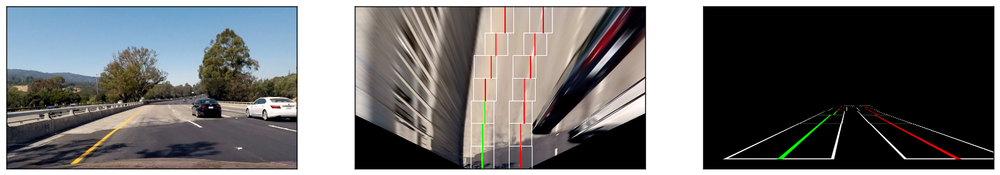

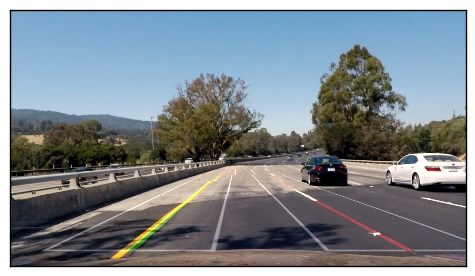

In [158]:
img_size = (und.shape[1], und.shape[0])    
Minv = get_perspective(img_size, inv=True)
# result = warp_back(und, warp, ffitl, ffitr)
overlay = cv2.warpPerspective(lines_img, Minv, img_size)

# Combine the result with the original image
result = cv2.addWeighted(und, 1, overlay, 0.3, 0)
plot_imgs([und, warp, overlay])
plot_imgs([result])

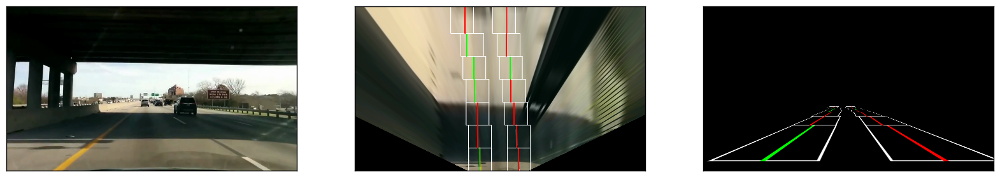

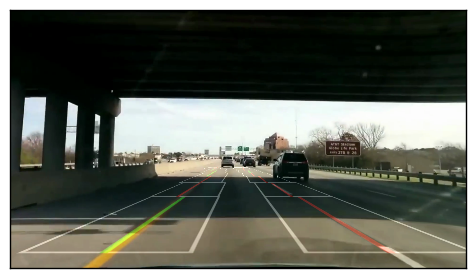

In [160]:
img_size = (und.shape[1], und.shape[0])    
Minv = get_perspective(img_size, inv=True)
# result = warp_back(und, warp, ffitl, ffitr)
overlay = cv2.warpPerspective(lines_img, Minv, img_size)

# Combine the result with the original image
result = cv2.addWeighted(und, 1, overlay, 0.3, 0)
plot_imgs([und, warp, overlay])
plot_imgs([result])

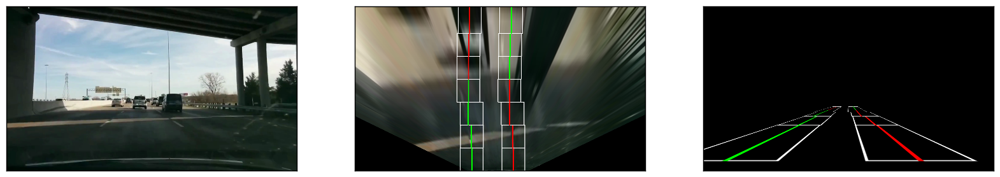

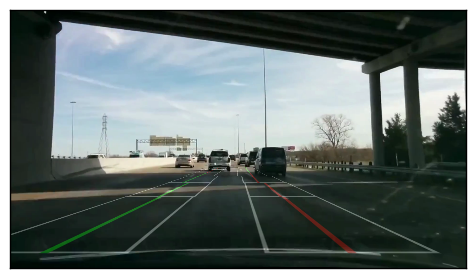

In [162]:
img_size = (und.shape[1], und.shape[0])    
Minv = get_perspective(img_size, inv=True)
# result = warp_back(und, warp, ffitl, ffitr)
overlay = cv2.warpPerspective(lines_img, Minv, img_size)

# Combine the result with the original image
result = cv2.addWeighted(und, 1, overlay, 0.3, 0)
plot_imgs([und, warp, overlay])
plot_imgs([result])

In [332]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/lane-change.mp4')
output_path = 'my_videos/lane-change-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video my_videos/lane-change-out.mp4
[MoviePy] Writing video my_videos/lane-change-out.mp4















  0%|          | 0/1192 [00:00<?, ?it/s]












  0%|          | 2/1192 [00:00<01:51, 10.67it/s]












  0%|          | 4/1192 [00:00<01:47, 11.07it/s]












  1%|          | 6/1192 [00:00<01:44, 11.30it/s]












  1%|          | 8/1192 [00:00<01:43, 11.49it/s]












  1%|          | 10/1192 [00:00<01:43, 11.38it/s]












  1%|          | 12/1192 [00:01<01:42, 11.56it/s]












  1%|          | 14/1192 [00:01<01:40, 11.70it/s]












  1%|▏         | 16/1192 [00:01<01:43, 11.33it/s]












  2%|▏         | 18/1192 [00:01<01:44, 11.27it/s]












  2%|▏         | 20/1192 [00:01<01:47, 10.95it/s]












  2%|▏         | 22/1192 [00:01<01:45, 11.06it/s]












  2%|▏         | 24/1192 [00:02<02:10,  8.98it/s]












  2%|▏         | 25/1192 [00:02<02:50,  6.86it/s]












  2%|▏         | 26/1192 [00:02<03:17,  5.89it/s]












  2%|▏         | 27/1192 [00:02<03:37,  5.36it/s]












  2%|▏  

[MoviePy] Done.
[MoviePy] >>>> Video ready: my_videos/lane-change-out.mp4 

CPU times: user 24min 12s, sys: 7.57 s, total: 24min 19s
Wall time: 7min 23s


In [ ]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/lines-in-middle.mp4')
output_path = 'my_videos/lines-in-middle-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video my_videos/lines-in-middle-out.mp4
[MoviePy] Writing video my_videos/lines-in-middle-out.mp4















  0%|          | 0/5037 [00:00<?, ?it/s]












  0%|          | 2/5037 [00:00<07:42, 10.88it/s]












  0%|          | 4/5037 [00:00<07:38, 10.97it/s]












  0%|          | 6/5037 [00:00<07:28, 11.23it/s]












  0%|          | 8/5037 [00:00<07:30, 11.17it/s]












  0%|          | 10/5037 [00:00<07:28, 11.20it/s]












  0%|          | 12/5037 [00:01<07:28, 11.20it/s]












  0%|          | 14/5037 [00:01<07:23, 11.33it/s]












  0%|          | 16/5037 [00:01<07:19, 11.44it/s]












  0%|          | 18/5037 [00:01<07:20, 11.40it/s]












  0%|          | 20/5037 [00:01<07:20, 11.39it/s]












  0%|          | 22/5037 [00:01<07:21, 11.36it/s]












  0%|          | 24/5037 [00:02<09:03,  9.22it/s]












  0%|          | 25/5037 [00:02<11:35,  7.21it/s]












  1%|          | 26/5037 [00:02<13:26,  6.21it/s]












  1%|          | 27/5037 [00:02<14:17,  5.84it/s]












  1%|   

[MoviePy] Done.
[MoviePy] >>>> Video ready: my_videos/lines-in-middle-out.mp4 

CPU times: user 2h 26min 45s, sys: 36.6 s, total: 2h 27min 21s
Wall time: 1h 12min 38s


In [ ]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/shade-by-line.mp4')
output_path = 'my_videos/shade-by-line-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

[MoviePy] >>>> Building video my_videos/shade-by-line-out.mp4
[MoviePy] Writing video my_videos/shade-by-line-out.mp4















  0%|          | 0/1018 [00:00<?, ?it/s]












  0%|          | 1/1018 [00:00<01:53,  8.99it/s]












  0%|          | 2/1018 [00:00<01:56,  8.73it/s]












  0%|          | 4/1018 [00:00<01:48,  9.31it/s]












  1%|          | 6/1018 [00:00<01:41,  9.98it/s]












  1%|          | 7/1018 [00:00<01:53,  8.89it/s]












  1%|          | 8/1018 [00:00<02:05,  8.05it/s]












  1%|          | 9/1018 [00:01<02:15,  7.47it/s]












  1%|          | 10/1018 [00:01<02:20,  7.16it/s]












  1%|          | 11/1018 [00:01<02:24,  6.99it/s]












  1%|          | 12/1018 [00:01<02:11,  7.67it/s]












  1%|▏         | 14/1018 [00:01<01:56,  8.61it/s]












  2%|▏         | 16/1018 [00:01<01:46,  9.43it/s]












  2%|▏         | 18/1018 [00:01<01:40,  9.98it/s]












  2%|▏         | 20/1018 [00:02<01:37, 10.27it/s]












  2%|▏         | 22/1018 [00:02<01:34, 10.53it/s]












  2%|▏     

In [ ]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/white-and-black.mp4')
output_path = 'my_videos/white-and-black-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

In [ ]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/white-on-black-lines.mp4')
output_path = 'my_videos/white-on-black-lines-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

In [ ]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/yellow-on-left.mp4')
output_path = 'my_videos/yellow-on-left-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

In [ ]:
vp = VideoProcessing()
vp.calibrate_from_path(udimg.shape[:2], 'my_cal/calibration*.jpg')

clip = VideoFileClip('my_videos/parking-lot-and-city.mp4')
output_path = 'my_videos/parking-lot-and-city-out.mp4'

output = clip.fl_image(vp.process_img)
%time output.write_videofile(output_path, audio=False)

In [ ]:
org = np.copy(udimg1)
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

# plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

gradx = abs_sobel_thresh(warp, orient='x', sobel_kernel=9, thresh=(30, 255))
S = hls_select(warp, selection='s', thresh=(100, 255))
G = rgb_select(warp, selection='g', thresh=(200, 255))

result = (gradx | G) & S

plot_side_by_side(org, 'Original Image', result, 'Birds-eye image')

In [ ]:
org = np.copy(udimg2)
und = undistort(org, udmtx, uddist)
warp, M = unwarp(und, udmtx, uddist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

# plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

gradx = abs_sobel_thresh(warp, orient='x', sobel_kernel=9, thresh=(30, 255))
S = hls_select(warp, selection='s', thresh=(100, 255))
G = rgb_select(warp, selection='g', thresh=(200, 255))

result = (gradx | G) & S

plot_side_by_side(org, 'Original Image', result, 'Birds-eye image')


In [ ]:
org = np.copy(myimg1)
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

# plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

gradx = abs_sobel_thresh(warp, orient='x', sobel_kernel=9, thresh=(30, 255))
S = hls_select(warp, selection='s', thresh=(100, 255))
G = rgb_select(warp, selection='g', thresh=(200, 255))

result = (gradx | G) & S

plot_side_by_side(org, 'Original Image', result, 'Birds-eye image')


In [ ]:
org = np.copy(myimg2)
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, mymtx, mydist)
sx = abs_sobel_thresh(warp, orient='x', sobel_kernel=3, thresh=(40, 90))

y, x = warp.shape[:2]
sx[:,:380] = 0
sx[:,850:] = 0
sx[:400,:] = 0

# plot_side_by_side(org, 'Original Image', sx, 'Birds-eye image')
pairs = get_peaks(sx, x//2)
print(pairs)

gradx = abs_sobel_thresh(warp, orient='x', sobel_kernel=9, thresh=(30, 255))
S = hls_select(warp, selection='s', thresh=(100, 255))
G = rgb_select(warp, selection='g', thresh=(200, 255))

result = (gradx | G) & S

plot_side_by_side(org, 'Original Image', result, 'Birds-eye image')


In [ ]:
org = myimg2
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)

R1 = rgb_select(warp, selection='r', thresh=(80, 255))
G1 = rgb_select(warp, selection='g', thresh=(80, 255))
B1 = rgb_select(warp, selection='b', thresh=(80, 255))

R2 = rgb_select(warp, selection='r', thresh=(100, 255))
G2 = rgb_select(warp, selection='g', thresh=(100, 255))
B2 = rgb_select(warp, selection='b', thresh=(100, 255))

plot_imgs([R1,G1,B1,R2,G2,B2], ['R1','G1','B1','R2','G2','B2'])

In [ ]:
H1 = hsv_select(warp, selection='h', thresh=(15, 100))
S1 = hsv_select(warp, selection='s', thresh=(50, 255))
V1 = hsv_select(warp, selection='v', thresh=(150, 255))

H2 = hsv_select(und2, selection='h', thresh=(15, 100))
S2 = hsv_select(und2, selection='s', thresh=(90, 255))
V2 = hsv_select(und2, selection='v', thresh=(150, 255))

plot_imgs([H1,S1,V1,H2,S2,V2],  ['H1','S1','V1','H2','S2','V2'])

In [ ]:
H1 = hls_select(warp, selection='h', thresh=(10, 100))
L1 = hls_select(warp, selection='l', thresh=(180, 255))
S1 = hls_select(warp, selection='s', thresh=(90, 255))

H2 = hls_select(und2, selection='h', thresh=(10, 100))
L2 = hls_select(und2, selection='l', thresh=(200, 255))
S2 = hls_select(und2, selection='s', thresh=(90, 255))

plot_imgs([H1,L1,S1,H2,L2,S2],  ['H1','L1','S1','H2','L2','S2'])

In [ ]:
grdx1 = abs_sobel_thresh(und1, orient='x', sobel_kernel=15, thresh=(30, 255))
grdy1 = abs_sobel_thresh(und1, orient='y', sobel_kernel=15, thresh=(50, 255))
magn1 = mag_thresh(und1, sobel_kernel=15, thresh=(70, 255))
drec1 = dir_threshold(und1, sobel_kernel=15, thresh=(.7, 1.3))

grdx2 = abs_sobel_thresh(und2, orient='x', sobel_kernel=15, thresh=(30, 255))
grdy2 = abs_sobel_thresh(und2, orient='y', sobel_kernel=15, thresh=(50, 255))
magn2 = mag_thresh(und2, sobel_kernel=15, thresh=(70, 255))
drec2 = dir_threshold(und2, sobel_kernel=15, thresh=(.7, 1.3))

f, axs = plt.subplots(4, 2, figsize=(15, 10))
f.tight_layout()

ax1, ax2 = axs[0]
ax3, ax4 = axs[1]
ax5, ax6 = axs[2]
ax7, ax8 = axs[3]

ax1.imshow(grdx1, cmap='gray')
ax1.set_title('Sobel X 1', fontsize=50)
ax2.imshow(grdx2, cmap='gray')
ax2.set_title('Sobel X 2', fontsize=50)
ax3.imshow(grdy1, cmap='gray')
ax3.set_title('Sobel Y 1', fontsize=50)
ax4.imshow(grdy2, cmap='gray')
ax4.set_title('Sobel Y 2', fontsize=50)

ax5.imshow(magn1, cmap='gray')
ax5.set_title('Magnitude 1', fontsize=50)
ax6.imshow(magn2, cmap='gray')
ax6.set_title('Magnitude 2', fontsize=50)
ax7.imshow(drec1, cmap='gray')
ax7.set_title('Direction 1', fontsize=50)
ax8.imshow(drec2, cmap='gray')
ax8.set_title('Direction 2', fontsize=50)

plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
plt.show()

In [ ]:
yellowimg1 = filter_yellow(udimg1)
whiteimg1 = filter_white(udimg1)
plot_imgs([udimg1, yellowimg1, whiteimg1], 
          ['Original', 'Yellow Filter', 'White Filter'])

In [ ]:
yellowimg1 = filter_yellow(udimg2)
whiteimg1 = filter_white(udimg2)
plot_imgs([udimg2, yellowimg1, whiteimg1], 
          ['Original', 'Yellow Filter', 'White Filter'])

In [ ]:
yellowimg1 = filter_yellow(myimg1)
whiteimg1 = filter_white(myimg1)
plot_imgs([myimg1, yellowimg1, whiteimg1], 
          ['Original', 'Yellow Filter', 'White Filter'])

In [ ]:
yellowimg1 = filter_yellow(myimg2)
whiteimg1 = filter_white(myimg2)
plot_imgs([myimg2, yellowimg1, whiteimg1], 
          ['Original', 'Yellow Filter', 'White Filter'])

Now that we've previewed few different techniques, we can stack up some of these techniques for a more precise detection.

In [ ]:
s = hls_select(udimg1, selection='s', thresh=(100, 255))
g = abs_sobel_thresh(s, orient='x', sobel_kernel=3, thresh=(100, 255))

y = filter_yellow(udimg1)
w = filter_white(udimg1)

plot_side_by_side(udimg1, 'Original Image', y | w | g, 'Stacked Filters')

In [ ]:
s = hls_select(udimg2, selection='s', thresh=(100, 255))
g = abs_sobel_thresh(s, orient='x', sobel_kernel=3, thresh=(100, 255))

y = filter_yellow(udimg2)
w = filter_white(udimg2)

plot_side_by_side(udimg2, 'Original Image', y | w | g, 'Stacked Filters')

In [ ]:
s = hls_select(myimg2, selection='s', thresh=(100, 255))
g = abs_sobel_thresh(s, orient='x', sobel_kernel=3, thresh=(100, 255))

y = filter_yellow(myimg2)
w = filter_white(myimg2)

plot_side_by_side(myimg2, 'Original Image', y | w | g, 'Stacked Filters')

In [ ]:
def plot_hist(img):
    histogram = np.sum(img[600:,:], axis=0)
    f, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 15))
    f.tight_layout()
    ax1.imshow(img, cmap='gray')
    plt.setp(ax1.get_xticklabels(), visible=False)
    ax2 = plt.subplot(212, sharex=ax1)
    plt.plot(histogram)
    plt.xlim(0, x)
    plt.show()

def detect_binary_lines(img):
    
    s = hls_select(img, selection='s', thresh=(100, 255))
    g = abs_sobel_thresh(s, orient='x', sobel_kernel=3, thresh=(80, 255))

    y = filter_yellow(img)
    w = filter_white(img)
    return np.array((y | w | g), dtype=np.uint8)    

Now, lets see how the pipeline is coming along:

In [ ]:
org = udimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
binary = detect_binary_lines(warp)
plot_side_by_side(org, 'Original Image', binary, 'Binary image')

In [ ]:
org = udimg2
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
binary = detect_binary_lines(warp)
plot_side_by_side(org, 'Original Image', binary, 'Binary image')

In [ ]:
org = myimg1
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
binary = detect_binary_lines(warp)
plot_side_by_side(org, 'Original Image', binary, 'Binary image')

In [ ]:
org = myimg2
und = undistort(org, mymtx, mydist)
warp, M = unwarp(und, udmtx, uddist)
binary = detect_binary_lines(warp)
plot_side_by_side(org, 'Original Image', binary, 'Binary image')

In [ ]:
mymtx, mydist = calibrate(imread(fnames[0]).shape[:2], myobjpoints, myimgpoints)

fnames = glob.glob('./my_images/*')
print()
for fname in fnames[:5]:
    img = ndimage.imread(fname)
    plot_side_by_side(img, 'Original Image', pipeline(img, mymtx, mydist), 'Binary image')

In [ ]:
def fit_lines(unwarpped):
    left = np.zeros_like(unwarpped)
    left[:,:unwarpped.shape[1]//2] = unwarpped[:,:unwarpped.shape[1]//2]

    right = np.zeros_like(unwarpped)
    right[:,unwarpped.shape[1]//2:] = unwarpped[:,unwarpped.shape[1]//2:]

    lpoints = cv2.findNonZero(left)
    rpoints = cv2.findNonZero(right)

    lyvals = lpoints[:,:,1].squeeze()
    ryvals = rpoints[:,:,1].squeeze()

    # Fit a second order polynomial to each fake lane line
    left_fit = np.polyfit(lyvals, lpoints[:,:,0].squeeze(), 2)
    #left_fitx = left_fit[0]*lyvals**2 + left_fit[1]*lyvals + left_fit[2]
    left_fitx = left_fit[0]*np.arange(720)**2 + left_fit[1]*np.arange(720) + left_fit[2]

    right_fit = np.polyfit(ryvals, rpoints[:,:,0].squeeze(), 2)
    #right_fitx = right_fit[0]*ryvals**2 + right_fit[1]*ryvals + right_fit[2]
    right_fitx = right_fit[0]*np.arange(720)**2 + right_fit[1]*np.arange(720) + right_fit[2]

    ## PLOTTING
    plt.plot(lpoints[:,:,0].squeeze(), lpoints[:,:,1].squeeze(), 'b.', markersize=3)
    plt.plot(rpoints[:,:,0].squeeze(), rpoints[:,:,1].squeeze(), 'r.', markersize=3)

    plt.xlim(0, 1280)
    plt.ylim(0, 720)
    plt.plot(left_fitx, np.arange(720), color='green', linewidth=3)
    plt.plot(right_fitx, np.arange(720), color='green', linewidth=3)
    plt.gca().invert_yaxis() # to visualize as we do the images
    plt.show()
    return lpoints, left_fitx, left_fit, rpoints, right_fitx, right_fit
    

NUM_BANDS = 25
TRACK_THRESHOLD = 20
BOX_HALF_WIDTH = 50

def fit_lines2(unwarpped):

    # find the curve
    left, right = get_lane_points(unwarpped)
    left_fitx, left_valsy, left_fit = fit_curve(left)
    right_fitx, right_valsy, right_fit = fit_curve(right)
    
    f, (ax1) = plt.subplots(1, 1, figsize=(20,10))
    ax1.set_title('')
    ax1.imshow(unwarpped, cmap='gray')
    add_points(ax1, left, 'b.')
    add_points(ax1, right, 'r.')
    plt.xlim(0, 1280)
    plt.ylim(0, 720)
    plt.plot(left_fitx, left_valsy, color='green', linewidth=3)
    plt.plot(right_fitx, right_valsy, color='green', linewidth=3)
    plt.gca().invert_yaxis() # to visualize as we do the images
    plt.show()
    
    return left, left_fitx, left_fit, right, right_fitx, right_fit

def find_point(histogram_, avg_height_, is_initialized_, min_edge_, max_edge_, last_center_, list_):
    # decide width to look in for max
    if is_initialized_ == True:
        left_edge = last_center_ - BOX_HALF_WIDTH
        right_edge = last_center_ + BOX_HALF_WIDTH            
    else:
        left_edge = min_edge_
        right_edge = max_edge_

    #print('\t(L_edge,R_edge)=({},{})'.format(left_edge, right_edge))
    # find the max
    center_guess = np.argmax(histogram_[left_edge:right_edge])+left_edge
    center_value = histogram_[center_guess]
    #print('\tcenter_guess: ', center_guess)
    #print('\tcenter_value: ', center_value)
    if center_value > TRACK_THRESHOLD:
        #print('\tappending...')
        list_.append((center_guess, avg_height_))
        last_center_ = center_guess
        if is_initialized_ == False:
            is_initialized_ = True

    return is_initialized_, last_center_, list_


def get_lane_points(img_):
    left = []
    right = []
    
    #band_start = img_.shape[0]
    band_depth = int(img_.shape[0]/NUM_BANDS)
    
    tops = np.arange(0, img_.shape[0]-1, band_depth)
    bottoms = tops + (band_depth-1)
    
    # reverse the arrays
    tops = tops[::-1]
    bottoms = bottoms[::-1]
    
    is_left_initialized = False
    is_right_initialized = False
    last_left_center = 0
    last_right_center = 0
    
    for index in range(len(tops)):
        print('(top, bottom)=({},{})'.format(tops[index], bottoms[index]))
        histogram = np.sum(img_[tops[index]:bottoms[index],:], axis=0)
        hist_len = histogram.shape[0]
        avg_height = (tops[index] + bottoms[index])/2

        is_left_initialized, last_left_center, left = find_point(histogram,
                                                                 avg_height,
                                                                 is_left_initialized, 
                                                                 0, 
                                                                 int(hist_len/2), 
                                                                 last_left_center, 
                                                                 left)
        
        is_right_initialized, last_right_center, right = find_point(histogram,
                                                                 avg_height,
                                                                 is_right_initialized, 
                                                                 int(hist_len/2), 
                                                                 hist_len-1, 
                                                                 last_right_center, 
                                                                 right)
            
    #print(left)
    
    return left, right
    

def fit_curve(points_):
    # get x and y values
    x_vals = np.asarray([pt_tuple[0] for pt_tuple in points_])
    y_vals = np.asarray([pt_tuple[1] for pt_tuple in points_])
    # Fit a second order polynomial
    fit_coeff = np.polyfit(y_vals, x_vals, 2)
    x_fit = fit_coeff[0]*y_vals**2 + fit_coeff[1]*y_vals + fit_coeff[2]
    return x_fit, y_vals, fit_coeff

def add_points(fig_, points_, marking_):
    for pt_tuple in points_:
        fig_.plot(pt_tuple[0],pt_tuple[1],marking_, markersize=30)

def get_curvature(lpoints, left_fit, rpoints, right_fit):

    if len(lpoints.shape) < 3:
        lpoints = np.array([lpoints])
        rpoints = np.array([rpoints])
    
    print(lpoints.shape, rpoints.shape)
    
    ly_eval = np.max(lpoints[:,:,1].squeeze())
    ry_eval = np.max(rpoints[:,:,1].squeeze())
    print(ly_eval, ry_eval)

    left_curverad = ((1 + (2*left_fit[0]*ly_eval + left_fit[1])**2)**1.5) \
                                 /np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*ry_eval + right_fit[1])**2)**1.5) \
                                    /np.absolute(2*right_fit[0])
    print(left_curverad, right_curverad)
    # Example values: 1163.9    1213.7
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension

    ly_eval = np.max(lpoints[:,:,1].squeeze())
    ry_eval = np.max(rpoints[:,:,1].squeeze())

    left_fit_cr = np.polyfit(lpoints[:,:,1].squeeze()*ym_per_pix, lpoints[:,:,0].squeeze()*xm_per_pix, 2)
    right_fit_cr = np.polyfit(rpoints[:,:,1].squeeze()*ym_per_pix, rpoints[:,:,0].squeeze()*xm_per_pix, 2)

    left_curverad = ((1 + (2*left_fit_cr[0]*ly_eval + left_fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*ry_eval + right_fit_cr[1])**2)**1.5) \
                                    /np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    print(left_curverad, 'm', right_curverad, 'm')

    return left_curverad, right_curverad

def warp_back(image, warped, left_fitx, right_fitx):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    print(left_fitx)
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, np.arange(720)]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, np.arange(720)])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    img_size = (image.shape[1], image.shape[0])    
    Minv = get_perspective(img_size, inv=True)
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    plt.imshow(result)
    plt.show()
    return result

def pipeline(img, mtx, dist):
    # undistort
    und = undistort(img, mtx, dist)
    binl = detect_binary_lines(und)
    unwarpped, M = unwarp(binl, mtx, dist)
    lpoints, left_fitx, left_fit, rpoints, right_fitx, right_fit = fit_lines2(unwarpped)
    lcurve, rcurve = get_curvature(lpoints, left_fit, rpoints, right_fit)
    result = warp_back(und, unwarpped, left_fitx, right_fitx)
    return result

#### Lane Curvature and Car Positioning

#### Putting Everything Together

### Processing Video

#### Confidence-Based Lane Detection

#### Confidence-Based Lane Tracking

### Results

#### Provided Videos

#### New Videos

### Reflections

#### Further Improvements

#### Hypothetical flaws